<a href="https://colab.research.google.com/github/mrarunsivakumar/Smart-Predictive-Modeling-for-Rental-Property-Prices/blob/main/Smart_Predictive_Modeling_for_Rental_Property_Prices.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Importing Libraries**

In [106]:
import pandas as pd
import numpy as np
import json
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
import pickle
pd.set_option('display.max_columns', None)
#To ignore warnings
import warnings
warnings.filterwarnings("ignore")

**Loading Dataset**

In [3]:
df_train = pd.read_excel('/content/House_Rent_Train.xlsx')
df_train

,id,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,amenities,water_supply,building_type,balconies,rent
0,ff8081815733a243015733b2876600a6,BHK2,NaN,21-04-2018 14:44,12.934471,77.634471,FAMILY,1,1,1,0,SEMI_FURNISHED,BOTH,1250,25.0,2.0,E,2.0,6.0,12.0,"{""LIFT"":true,""GYM"":true,""INTERNET"":true,""AC"":f...",CORP_BORE,AP,2.0,40000.0
1,ff8081815ee25e15015ee50004da2acd,BHK2,Bellandur,2017-09-10 12:48:00,12.929557,77.672280,ANYONE,0,1,0,1,SEMI_FURNISHED,BOTH,1400,4.0,2.0,NE,2.0,3.0,4.0,"{""LIFT"":true,""GYM"":false,""INTERNET"":false,""AC""...",CORPORATION,AP,2.0,22000.0
2,ff80818163f29c9e0163f46770b873e7,BHK3,Thiruvanmiyur,2018-12-06 22:02:00,12.982870,80.262012,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1350,6.0,3.0,E,3.0,1.0,5.0,"{""LIFT"":true,""GYM"":false,""INTERNET"":false,""AC""...",CORP_BORE,AP,3.0,28000.0
3,ff80818164b68a700164b74b1b247a1d,BHK1,Attiguppe,20-07-2018 16:22,12.955991,77.531634,FAMILY,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,600,3.0,1.0,E,1.0,1.0,2.0,"{""LIFT"":false,""GYM"":false,""INTERNET"":false,""AC...",CORPORATION,IH,0.0,8000.0
4,ff80818163b1faf00163b4b9b8a163b1,BHK3,Kodihalli,31-05-2018 17:41,12.963903,77.649446,FAMILY,0,0,0,1,SEMI_FURNISHED,BOTH,1500,15.0,3.0,E,4.0,0.0,0.0,"{""LIFT"":false,""GYM"":false,""INTERNET"":false,""AC...",CORPORATION,IH,1.0,45000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20550,19,NaN,NaN,NaN,NaN,NaN,NaN,1,1,1,1,SEMI_FURNISHED,BOTH,1650,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20551,20,BHK2,NaN,NaN,NaN,NaN,NaN,0,0,0,1,SEMI_FURNISHED,BOTH,1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20552,21,BHK2,NaN,NaN,NaN,NaN,NaN,1,1,0,1,SEMI_FURNISHED,BOTH,1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20553,22,BHK2,NaN,NaN,NaN,NaN,NaN,0,1,0,0,SEMI_FURNISHED,BOTH,1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
#To view the column names
df_train.columns

Index(['id', 'type', 'locality', 'activation_date', 'latitude', 'longitude',
       'lease_type', 'gym', 'lift', 'swimming_pool', 'negotiable',
       'furnishing', 'parking', 'property_size', 'property_age', 'bathroom',
       'facing', 'cup_board', 'floor', 'total_floor', 'amenities',
       'water_supply', 'building_type', 'balconies', 'rent'],
      dtype='object')

**Data Cleaning**

In [5]:
# drop id columns

df_train.drop(columns='id', inplace=True)
df_train.tail()

,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,amenities,water_supply,building_type,balconies,rent
20550,NaN,NaN,NaN,NaN,NaN,NaN,1,1,1,1,SEMI_FURNISHED,BOTH,1650,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20551,BHK2,NaN,NaN,NaN,NaN,NaN,0,0,0,1,SEMI_FURNISHED,BOTH,1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20552,BHK2,NaN,NaN,NaN,NaN,NaN,1,1,0,1,SEMI_FURNISHED,BOTH,1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20553,BHK2,NaN,NaN,NaN,NaN,NaN,0,1,0,0,SEMI_FURNISHED,BOTH,1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20554,BHK1,NaN,NaN,NaN,NaN,NaN,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**Missing Values**

In [6]:
df_train.isnull().sum()

type                27
locality           160
activation_date     23
latitude            23
longitude           23
lease_type          23
gym                  0
lift                 0
swimming_pool        0
negotiable           0
furnishing           0
parking              0
property_size        0
property_age        23
bathroom            23
facing              23
cup_board           23
floor               23
total_floor         23
amenities           23
water_supply        23
building_type       23
balconies           23
rent                23
dtype: int64

In [7]:
# drop the null values

df_train = df_train.dropna().reset_index(drop=True)
df_train.head()

,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,amenities,water_supply,building_type,balconies,rent
0,BHK2,Bellandur,2017-09-10 12:48:00,12.929557,77.672280,ANYONE,0,1,0,1,SEMI_FURNISHED,BOTH,1400,4.0,2.0,NE,2.0,3.0,4.0,"{""LIFT"":true,""GYM"":false,""INTERNET"":false,""AC""...",CORPORATION,AP,2.0,22000.0
1,BHK3,Thiruvanmiyur,2018-12-06 22:02:00,12.982870,80.262012,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1350,6.0,3.0,E,3.0,1.0,5.0,"{""LIFT"":true,""GYM"":false,""INTERNET"":false,""AC""...",CORP_BORE,AP,3.0,28000.0
2,BHK1,Attiguppe,20-07-2018 16:22,12.955991,77.531634,FAMILY,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,600,3.0,1.0,E,1.0,1.0,2.0,"{""LIFT"":false,""GYM"":false,""INTERNET"":false,""AC...",CORPORATION,IH,0.0,8000.0
3,BHK3,Kodihalli,31-05-2018 17:41,12.963903,77.649446,FAMILY,0,0,0,1,SEMI_FURNISHED,BOTH,1500,15.0,3.0,E,4.0,0.0,0.0,"{""LIFT"":false,""GYM"":false,""INTERNET"":false,""AC...",CORPORATION,IH,1.0,45000.0
4,BHK1,"Seetharampalya,Hoodi",24-10-2017 18:29,12.986196,77.718314,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1080,0.0,2.0,E,1.0,3.0,5.0,"{""LIFT"":true,""GYM"":true,""INTERNET"":false,""AC"":...",CORP_BORE,AP,2.0,18000.0


In [8]:
df_train.isnull().sum()


type               0
locality           0
activation_date    0
latitude           0
longitude          0
lease_type         0
gym                0
lift               0
swimming_pool      0
negotiable         0
furnishing         0
parking            0
property_size      0
property_age       0
bathroom           0
facing             0
cup_board          0
floor              0
total_floor        0
amenities          0
water_supply       0
building_type      0
balconies          0
rent               0
dtype: int64

In [9]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20377 entries, 0 to 20376
Data columns (total 24 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   type             20377 non-null  object 
 1   locality         20377 non-null  object 
 2   activation_date  20377 non-null  object 
 3   latitude         20377 non-null  float64
 4   longitude        20377 non-null  float64
 5   lease_type       20377 non-null  object 
 6   gym              20377 non-null  int64  
 7   lift             20377 non-null  int64  
 8   swimming_pool    20377 non-null  int64  
 9   negotiable       20377 non-null  int64  
 10  furnishing       20377 non-null  object 
 11  parking          20377 non-null  object 
 12  property_size    20377 non-null  int64  
 13  property_age     20377 non-null  float64
 14  bathroom         20377 non-null  float64
 15  facing           20377 non-null  object 
 16  cup_board        20377 non-null  float64
 17  floor       

In [10]:
df_train.loc[0,'amenities']

'{"LIFT":true,"GYM":false,"INTERNET":false,"AC":false,"CLUB":false,"INTERCOM":false,"POOL":false,"CPA":false,"FS":false,"SERVANT":false,"SECURITY":true,"SC":true,"GP":false,"PARK":true,"RWH":true,"STP":true,"HK":false,"PB":true,"VP":true}'

In [11]:
df_train.loc[5,'amenities']

'{"LIFT":true,"GYM":true,"INTERNET":true,"AC":true,"CLUB":true,"INTERCOM":true,"POOL":true,"CPA":true,"FS":true,"SERVANT":true,"SECURITY":true,"SC":true,"GP":false,"PARK":true,"RWH":true,"STP":true,"HK":true,"PB":true,"VP":true}'

In [12]:
# convert string dictionary into dictionary

def amenities_encoding(amenities):

    # load the string dictionary to json [convert true=True and false=False - boolean format]
    a = json.loads(amenities)

    # value = True means convert to 1, else convert to 0 ----> [so True convert to 1 and False convert to 0]
    b = {key:1 if value else 0 for key,value in a.items()}

    # remove the existing column in df
    for i in ['LIFT','GYM','POOL']:
        b.pop(i, None)

    return b

In [13]:
# string dictionary convert to dictionary

df_train['amenities'] = df_train['amenities'].apply(lambda x: amenities_encoding(x))
df_train.head()


,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,amenities,water_supply,building_type,balconies,rent
0,BHK2,Bellandur,2017-09-10 12:48:00,12.929557,77.672280,ANYONE,0,1,0,1,SEMI_FURNISHED,BOTH,1400,4.0,2.0,NE,2.0,3.0,4.0,"{'INTERNET': 0, 'AC': 0, 'CLUB': 0, 'INTERCOM'...",CORPORATION,AP,2.0,22000.0
1,BHK3,Thiruvanmiyur,2018-12-06 22:02:00,12.982870,80.262012,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1350,6.0,3.0,E,3.0,1.0,5.0,"{'INTERNET': 0, 'AC': 0, 'CLUB': 0, 'INTERCOM'...",CORP_BORE,AP,3.0,28000.0
2,BHK1,Attiguppe,20-07-2018 16:22,12.955991,77.531634,FAMILY,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,600,3.0,1.0,E,1.0,1.0,2.0,"{'INTERNET': 0, 'AC': 0, 'CLUB': 0, 'INTERCOM'...",CORPORATION,IH,0.0,8000.0
3,BHK3,Kodihalli,31-05-2018 17:41,12.963903,77.649446,FAMILY,0,0,0,1,SEMI_FURNISHED,BOTH,1500,15.0,3.0,E,4.0,0.0,0.0,"{'INTERNET': 0, 'AC': 0, 'CLUB': 0, 'INTERCOM'...",CORPORATION,IH,1.0,45000.0
4,BHK1,"Seetharampalya,Hoodi",24-10-2017 18:29,12.986196,77.718314,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1080,0.0,2.0,E,1.0,3.0,5.0,"{'INTERNET': 0, 'AC': 0, 'CLUB': 1, 'INTERCOM'...",CORP_BORE,AP,2.0,18000.0


In [14]:
# make new dataframe for amenities dictionary
amenities_df = pd.DataFrame(df_train['amenities'].tolist(), index=df_train.index)

# column names convert to lower case
amenities_df.columns = amenities_df.columns.str.lower()
amenities_df.head()

,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp
0,0,0,0.0,0,0.0,0,0.0,1,1,0.0,1,1.0,1.0,0,1,1.0
1,0,0,0.0,0,1.0,0,0.0,0,1,0.0,1,0.0,0.0,0,1,1.0
2,0,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0
3,0,0,0.0,0,1.0,0,0.0,0,0,0.0,1,0.0,0.0,0,0,1.0
4,0,0,1.0,0,1.0,1,0.0,1,0,0.0,0,0.0,0.0,0,1,0.0


In [15]:
# concatinate amenities dataframe with df

df_train = pd.concat([df_train, amenities_df], axis=1)
df_train.drop(columns='amenities', inplace=True)
df_train.head()

,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,rent,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp
0,BHK2,Bellandur,2017-09-10 12:48:00,12.929557,77.672280,ANYONE,0,1,0,1,SEMI_FURNISHED,BOTH,1400,4.0,2.0,NE,2.0,3.0,4.0,CORPORATION,AP,2.0,22000.0,0,0,0.0,0,0.0,0,0.0,1,1,0.0,1,1.0,1.0,0,1,1.0
1,BHK3,Thiruvanmiyur,2018-12-06 22:02:00,12.982870,80.262012,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1350,6.0,3.0,E,3.0,1.0,5.0,CORP_BORE,AP,3.0,28000.0,0,0,0.0,0,1.0,0,0.0,0,1,0.0,1,0.0,0.0,0,1,1.0
2,BHK1,Attiguppe,20-07-2018 16:22,12.955991,77.531634,FAMILY,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,600,3.0,1.0,E,1.0,1.0,2.0,CORPORATION,IH,0.0,8000.0,0,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0
3,BHK3,Kodihalli,31-05-2018 17:41,12.963903,77.649446,FAMILY,0,0,0,1,SEMI_FURNISHED,BOTH,1500,15.0,3.0,E,4.0,0.0,0.0,CORPORATION,IH,1.0,45000.0,0,0,0.0,0,1.0,0,0.0,0,0,0.0,1,0.0,0.0,0,0,1.0
4,BHK1,"Seetharampalya,Hoodi",24-10-2017 18:29,12.986196,77.718314,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1080,0.0,2.0,E,1.0,3.0,5.0,CORP_BORE,AP,2.0,18000.0,0,0,1.0,0,1.0,1,0.0,1,0,0.0,0,0.0,0.0,0,1,0.0


In [16]:
df_train.isnull().sum()

type                  0
locality              0
activation_date       0
latitude              0
longitude             0
lease_type            0
gym                   0
lift                  0
swimming_pool         0
negotiable            0
furnishing            0
parking               0
property_size         0
property_age          0
bathroom              0
facing                0
cup_board             0
floor                 0
total_floor           0
water_supply          0
building_type         0
balconies             0
rent                  0
internet              0
ac                    0
club               1055
intercom              0
cpa                1055
fs                    0
servant            1055
security              0
sc                    0
gp                 1055
park                  0
rwh                1055
stp                1055
hk                    0
pb                    0
vp                 1055
dtype: int64

In [17]:
#  replace null values with 0

df_train.fillna(0, inplace=True)
df_train.tail()

,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,rent,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp
20372,BHK1,Ulsoor,2017-11-10 17:08:00,12.979762,77.615395,ANYONE,0,1,0,1,SEMI_FURNISHED,TWO_WHEELER,850,30.0,2.0,E,1.0,1.0,4.0,CORP_BORE,AP,1.0,20000.0,1,0,0.0,0,0.0,1,0.0,1,1,1.0,1,0.0,0.0,1,0,1.0
20373,BHK2,Koramangala 4th Block,19-10-2017 20:31,12.931072,77.632361,ANYONE,0,0,0,1,SEMI_FURNISHED,BOTH,1000,10.0,2.0,N,2.0,1.0,2.0,CORPORATION,IH,2.0,30000.0,1,0,0.0,0,0.0,0,0.0,0,1,0.0,1,1.0,0.0,0,0,0.0
20374,BHK2,Kumaraswamy Layout,21-12-2017 21:18,12.901800,77.566597,FAMILY,1,1,0,1,SEMI_FURNISHED,BOTH,1000,0.0,2.0,W,2.0,5.0,5.0,BOREWELL,AP,2.0,16000.0,1,0,1.0,0,1.0,0,0.0,1,0,0.0,1,0.0,0.0,0,1,0.0
20375,BHK2,Indiranagar,28-06-2018 21:58,12.965502,77.647694,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1000,5.0,2.0,E,2.0,2.0,4.0,CORP_BORE,AP,3.0,30000.0,1,0,0.0,0,1.0,1,0.0,1,1,0.0,1,0.0,0.0,1,1,1.0
20376,BHK1,Malleshwaram West,2018-08-07 22:31:00,12.998645,77.574336,ANYONE,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,500,3.0,1.0,E,1.0,1.0,1.0,CORPORATION,IH,1.0,8500.0,0,0,0.0,0,0.0,0,0.0,0,1,0.0,1,0.0,0.0,0,0,0.0


In [18]:
df_train.isnull().sum()

type               0
locality           0
activation_date    0
latitude           0
longitude          0
lease_type         0
gym                0
lift               0
swimming_pool      0
negotiable         0
furnishing         0
parking            0
property_size      0
property_age       0
bathroom           0
facing             0
cup_board          0
floor              0
total_floor        0
water_supply       0
building_type      0
balconies          0
rent               0
internet           0
ac                 0
club               0
intercom           0
cpa                0
fs                 0
servant            0
security           0
sc                 0
gp                 0
park               0
rwh                0
stp                0
hk                 0
pb                 0
vp                 0
dtype: int64

In [19]:
df_train1 = df_train
df_train1.head()

,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,rent,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp
0,BHK2,Bellandur,2017-09-10 12:48:00,12.929557,77.672280,ANYONE,0,1,0,1,SEMI_FURNISHED,BOTH,1400,4.0,2.0,NE,2.0,3.0,4.0,CORPORATION,AP,2.0,22000.0,0,0,0.0,0,0.0,0,0.0,1,1,0.0,1,1.0,1.0,0,1,1.0
1,BHK3,Thiruvanmiyur,2018-12-06 22:02:00,12.982870,80.262012,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1350,6.0,3.0,E,3.0,1.0,5.0,CORP_BORE,AP,3.0,28000.0,0,0,0.0,0,1.0,0,0.0,0,1,0.0,1,0.0,0.0,0,1,1.0
2,BHK1,Attiguppe,20-07-2018 16:22,12.955991,77.531634,FAMILY,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,600,3.0,1.0,E,1.0,1.0,2.0,CORPORATION,IH,0.0,8000.0,0,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0
3,BHK3,Kodihalli,31-05-2018 17:41,12.963903,77.649446,FAMILY,0,0,0,1,SEMI_FURNISHED,BOTH,1500,15.0,3.0,E,4.0,0.0,0.0,CORPORATION,IH,1.0,45000.0,0,0,0.0,0,1.0,0,0.0,0,0,0.0,1,0.0,0.0,0,0,1.0
4,BHK1,"Seetharampalya,Hoodi",24-10-2017 18:29,12.986196,77.718314,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1080,0.0,2.0,E,1.0,3.0,5.0,CORP_BORE,AP,2.0,18000.0,0,0,1.0,0,1.0,1,0.0,1,0,0.0,0,0.0,0.0,0,1,0.0


In [20]:
df_train1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20377 entries, 0 to 20376
Data columns (total 39 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   type             20377 non-null  object 
 1   locality         20377 non-null  object 
 2   activation_date  20377 non-null  object 
 3   latitude         20377 non-null  float64
 4   longitude        20377 non-null  float64
 5   lease_type       20377 non-null  object 
 6   gym              20377 non-null  int64  
 7   lift             20377 non-null  int64  
 8   swimming_pool    20377 non-null  int64  
 9   negotiable       20377 non-null  int64  
 10  furnishing       20377 non-null  object 
 11  parking          20377 non-null  object 
 12  property_size    20377 non-null  int64  
 13  property_age     20377 non-null  float64
 14  bathroom         20377 non-null  float64
 15  facing           20377 non-null  object 
 16  cup_board        20377 non-null  float64
 17  floor       

In [21]:
# data type convertion
df_train1['activation_date'] = pd.to_datetime(df_train1['activation_date'])
df_train1.tail(2)

,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,rent,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp
20375,BHK2,Indiranagar,2018-06-28 21:58:00,12.965502,77.647694,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1000,5.0,2.0,E,2.0,2.0,4.0,CORP_BORE,AP,3.0,30000.0,1,0,0.0,0,1.0,1,0.0,1,1,0.0,1,0.0,0.0,1,1,1.0
20376,BHK1,Malleshwaram West,2018-08-07 22:31:00,12.998645,77.574336,ANYONE,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,500,3.0,1.0,E,1.0,1.0,1.0,CORPORATION,IH,1.0,8500.0,0,0,0.0,0,0.0,0,0.0,0,1,0.0,1,0.0,0.0,0,0,0.0


In [22]:
# date column split into day, month, year columns

df_train1['activation_day'] =df_train1['activation_date'].dt.day
df_train1['activation_month'] = df_train1['activation_date'].dt.month
df_train1['activation_year'] = df_train1['activation_date'].dt.year
df_train1.drop(columns='activation_date', inplace=True)
df_train1.head(3)


,type,locality,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,rent,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,activation_day,activation_month,activation_year
0,BHK2,Bellandur,12.929557,77.672280,ANYONE,0,1,0,1,SEMI_FURNISHED,BOTH,1400,4.0,2.0,NE,2.0,3.0,4.0,CORPORATION,AP,2.0,22000.0,0,0,0.0,0,0.0,0,0.0,1,1,0.0,1,1.0,1.0,0,1,1.0,10,9,2017
1,BHK3,Thiruvanmiyur,12.982870,80.262012,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1350,6.0,3.0,E,3.0,1.0,5.0,CORP_BORE,AP,3.0,28000.0,0,0,0.0,0,1.0,0,0.0,0,1,0.0,1,0.0,0.0,0,1,1.0,6,12,2018
2,BHK1,Attiguppe,12.955991,77.531634,FAMILY,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,600,3.0,1.0,E,1.0,1.0,2.0,CORPORATION,IH,0.0,8000.0,0,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0,20,7,2018


In [23]:
# calculate the count of amenities

df_train1['no_of_amenities'] = df_train1['gym'] + df_train1['lift'] + df_train1['swimming_pool'] + df_train1['internet'] +df_train1['ac'] + df_train1['club'] + df_train1['intercom'] + df_train1['cpa'] + df_train1['fs'] + df_train1['servant'] + df_train1['security'] + df_train1['sc'] + df_train1['gp'] + df_train1['park'] +df_train1['rwh'] + df_train1['stp'] + df_train1['hk'] + df_train1['pb'] + df_train1['vp']
df_train1.head(3)

,type,locality,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,rent,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,activation_day,activation_month,activation_year,no_of_amenities
0,BHK2,Bellandur,12.929557,77.672280,ANYONE,0,1,0,1,SEMI_FURNISHED,BOTH,1400,4.0,2.0,NE,2.0,3.0,4.0,CORPORATION,AP,2.0,22000.0,0,0,0.0,0,0.0,0,0.0,1,1,0.0,1,1.0,1.0,0,1,1.0,10,9,2017,8.0
1,BHK3,Thiruvanmiyur,12.982870,80.262012,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1350,6.0,3.0,E,3.0,1.0,5.0,CORP_BORE,AP,3.0,28000.0,0,0,0.0,0,1.0,0,0.0,0,1,0.0,1,0.0,0.0,0,1,1.0,6,12,2018,6.0
2,BHK1,Attiguppe,12.955991,77.531634,FAMILY,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,600,3.0,1.0,E,1.0,1.0,2.0,CORPORATION,IH,0.0,8000.0,0,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0,20,7,2018,0.0


In [24]:
df_train1.describe()

,latitude,longitude,gym,lift,swimming_pool,negotiable,property_size,property_age,bathroom,cup_board,floor,total_floor,balconies,rent,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,activation_day,activation_month,activation_year,no_of_amenities
count,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000
mean,12.945750,77.637238,0.226235,0.361142,0.174461,0.711488,1061.437209,5.777053,1.857732,4.567503,1.869510,3.798106,1.147863,19048.502969,0.661825,0.042548,0.185601,0.192865,0.291701,0.234676,0.037150,0.472984,0.471512,0.099917,0.506012,0.246503,0.170535,0.198557,0.364921,0.238553,15.344555,6.325072,2017.637336,5.177700
std,0.029587,0.110758,0.418404,0.480344,0.379515,0.453081,591.857798,6.362450,0.710933,336.427053,2.181633,3.183849,0.993290,8433.444157,0.473100,0.201841,0.388794,0.394557,0.454557,0.423807,0.189133,0.499282,0.499200,0.299896,0.499976,0.430986,0.376112,0.398924,0.481420,0.426209,8.864386,3.251640,0.480781,4.570412
min,12.900004,77.500072,0.000000,0.000000,0.000000,0.000000,1.000000,-1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,8000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,2017.000000,0.000000
25%,12.918232,77.571912,0.000000,0.000000,0.000000,0.000000,700.000000,1.000000,1.000000,1.000000,1.000000,2.000000,0.000000,12500.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,4.000000,2017.000000,2.000000
50%,12.943792,77.633367,0.000000,0.000000,0.000000,1.000000,1044.000000,5.000000,2.000000,2.000000,1.000000,3.000000,1.000000,17500.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15.000000,6.000000,2018.000000,3.000000
75%,12.970922,77.695692,0.000000,1.000000,0.000000,1.000000,1280.000000,10.000000,2.000000,3.000000,2.000000,4.000000,2.000000,24000.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,23.000000,9.000000,2018.000000,8.000000
max,12.999999,80.266346,1.000000,1.000000,1.000000,1.000000,50000.000000,400.000000,21.000000,48026.000000,25.000000,26.000000,13.000000,50000.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,31.000000,12.000000,2018.000000,19.000000


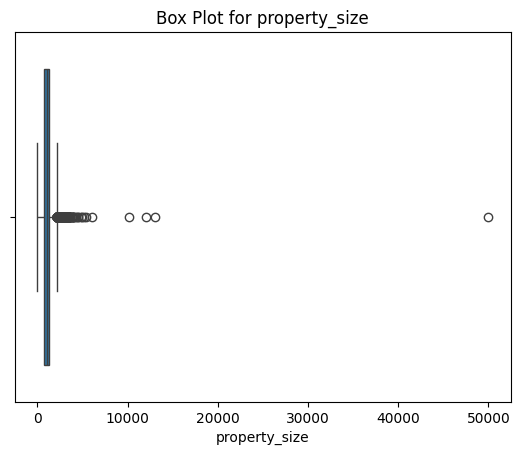

In [25]:
sns.boxplot(x=df_train1['property_size'])
plt.title('Box Plot for property_size')
plt.show()

In [26]:
#detecting Outlier for property_size	 column
iqr = df_train1['property_size'].quantile(0.75) - df_train1['property_size'].quantile(0.25)
upper_threshold = df_train1['property_size'].quantile(0.75) + (1.5 * iqr)
lower_threshold = df_train1['property_size'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold

(2150.0, -170.0)

In [27]:
#removing outlier for property_size column
# Clip/ Strip is used to detuct value to lower & upper threshold.
df_train1.property_size	 = df_train1.property_size.clip(lower_threshold, upper_threshold)

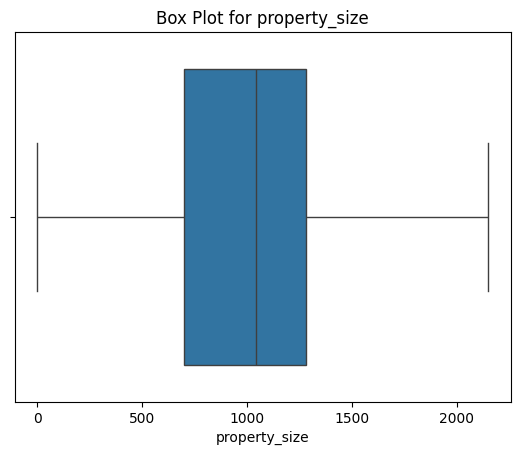

In [28]:
sns.boxplot(x=df_train1['property_size'])
plt.title('Box Plot for property_size')
plt.show()

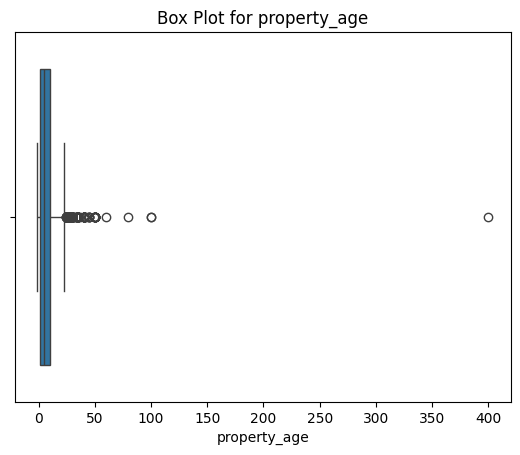

In [29]:
sns.boxplot(x=df_train1['property_age'])
plt.title('Box Plot for property_age')
plt.show()

In [30]:
#detecting Outlier for property_size	 column
iqr = df_train1['property_age'].quantile(0.75) - df_train1['property_age'].quantile(0.25)
upper_threshold = df_train1['property_age'].quantile(0.75) + (1.5 * iqr)
lower_threshold = df_train1['property_age'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold

(23.5, -12.5)

In [31]:
#removing outlier for property_size column
# Clip/ Strip is used to detuct value to lower & upper threshold.
df_train1.property_age	 = df_train1.property_age.clip(lower_threshold, upper_threshold)

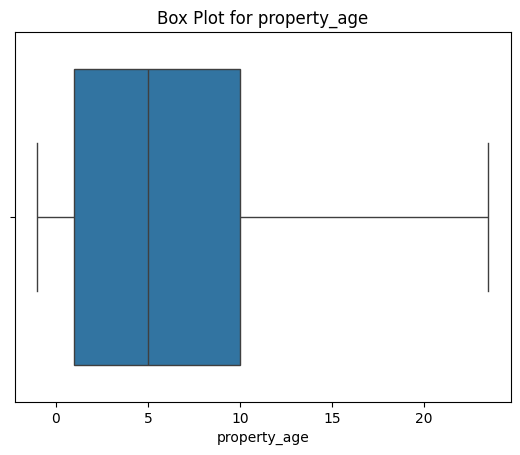

In [32]:
sns.boxplot(x=df_train['property_age'])
plt.title('Box Plot for property_age')
plt.show()

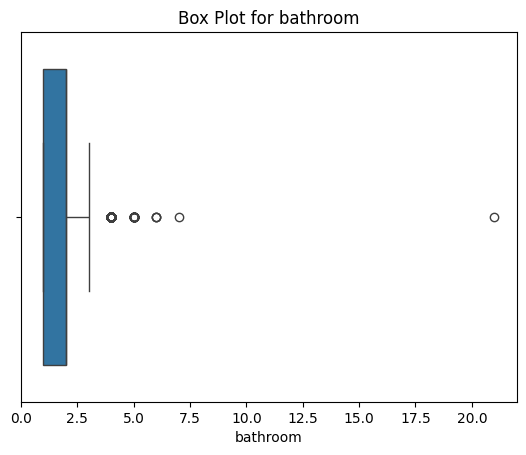

In [33]:
sns.boxplot(x=df_train1['bathroom'])
plt.title('Box Plot for bathroom')
plt.show()

In [34]:
#detecting Outlier for property_size	 column
iqr = df_train1['bathroom'].quantile(0.75) - df_train1['bathroom'].quantile(0.25)
upper_threshold = df_train1['bathroom'].quantile(0.75) + (1.5 * iqr)
lower_threshold = df_train1['bathroom'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold

(3.5, -0.5)

In [35]:
#removing outlier for bathroom column
# Clip/ Strip is used to detuct value to lower & upper threshold.
df_train1.bathroom	 = df_train1.bathroom.clip(lower_threshold, upper_threshold)

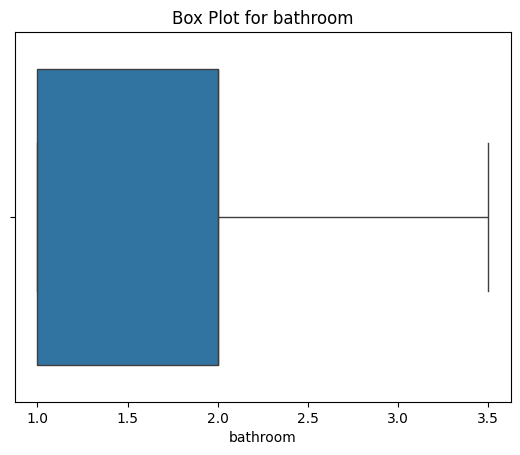

In [36]:
sns.boxplot(x=df_train1['bathroom'])
plt.title('Box Plot for bathroom')
plt.show()

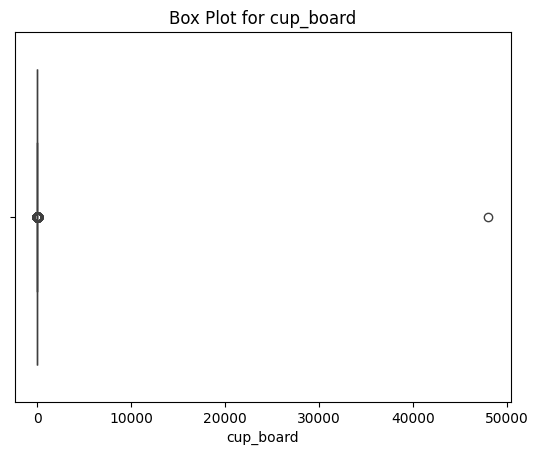

In [37]:
sns.boxplot(x=df_train1['cup_board'])
plt.title('Box Plot for cup_board')
plt.show()

In [38]:
#detecting Outlier for cup_board	 column
iqr = df_train1['cup_board'].quantile(0.75) - df_train1['cup_board'].quantile(0.25)
upper_threshold = df_train1['cup_board'].quantile(0.75) + (1.5 * iqr)
lower_threshold = df_train1['cup_board'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold

(6.0, -2.0)

In [39]:
#removing outlier for cup_board column
# Clip/ Strip is used to detuct value to lower & upper threshold.
df_train1.cup_board	 = df_train1.cup_board.clip(lower_threshold, upper_threshold)

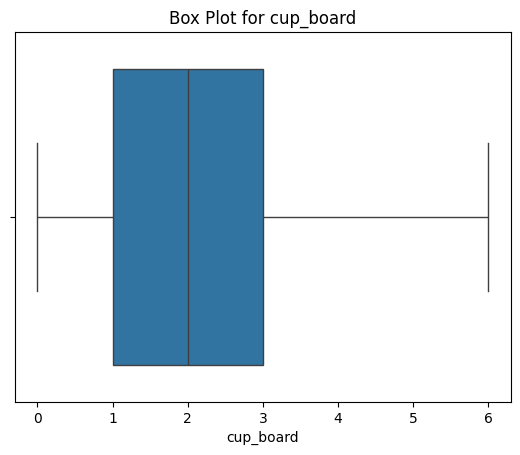

In [40]:
sns.boxplot(x=df_train1['cup_board'])
plt.title('Box Plot for cup_board')
plt.show()

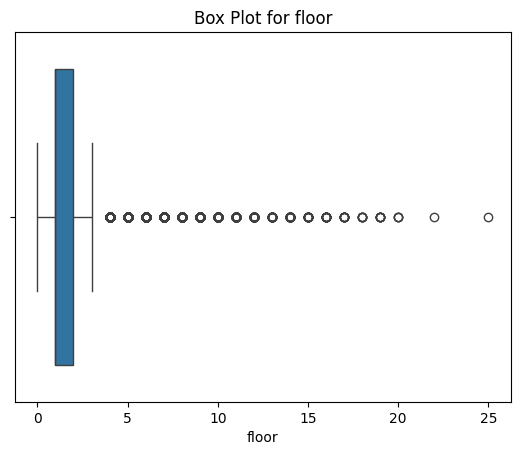

In [41]:
sns.boxplot(x=df_train1['floor'])
plt.title('Box Plot for floor')
plt.show()

In [42]:
#detecting Outlier for floor	 column
iqr = df_train['floor'].quantile(0.75) - df_train1['floor'].quantile(0.25)
upper_threshold = df_train1['floor'].quantile(0.75) + (1.5 * iqr)
lower_threshold = df_train1['floor'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold

(3.5, -0.5)

In [43]:
#removing outlier for floor column
# Clip/ Strip is used to detuct value to lower & upper threshold.
df_train1.floor	 = df_train1.floor.clip(lower_threshold, upper_threshold)

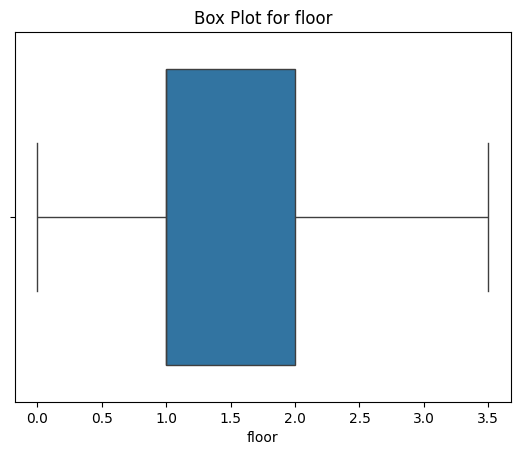

In [44]:
sns.boxplot(x=df_train1['floor'])
plt.title('Box Plot for floor')
plt.show()

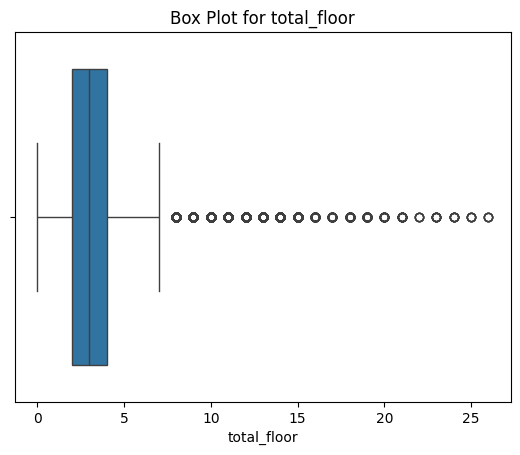

In [45]:
sns.boxplot(x=df_train1['total_floor'])
plt.title('Box Plot for total_floor')
plt.show()

In [46]:
#detecting Outlier for total_floor	 column
iqr = df_train1['total_floor'].quantile(0.75) - df_train1['total_floor'].quantile(0.25)
upper_threshold = df_train1['total_floor'].quantile(0.75) + (1.5 * iqr)
lower_threshold = df_train1['total_floor'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold

(7.0, -1.0)

In [47]:
#removing outlier for total_floor column
# Clip/ Strip is used to detuct value to lower & upper threshold.
df_train1.total_floor	 = df_train1.total_floor.clip(lower_threshold, upper_threshold)

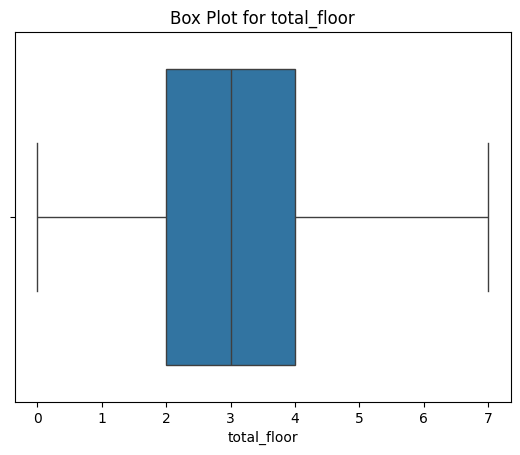

In [48]:
sns.boxplot(x=df_train1['total_floor'])
plt.title('Box Plot for total_floor')
plt.show()

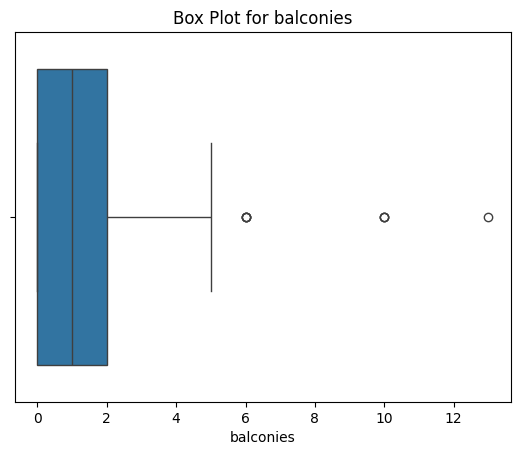

In [49]:
sns.boxplot(x=df_train1['balconies'])
plt.title('Box Plot for balconies')
plt.show()

In [50]:
#detecting Outlier for balconies		 column
iqr = df_train1['balconies'].quantile(0.75) - df_train1['balconies'].quantile(0.25)
upper_threshold = df_train1['balconies'].quantile(0.75) + (1.5 * iqr)
lower_threshold = df_train1['balconies'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold

(5.0, -3.0)

In [107]:
#removing outlier for balconies column
# Clip/ Strip is used to detuct value to lower & upper threshold.
df_train1.balconies		 = df_train1.balconies	.clip(lower_threshold, upper_threshold)

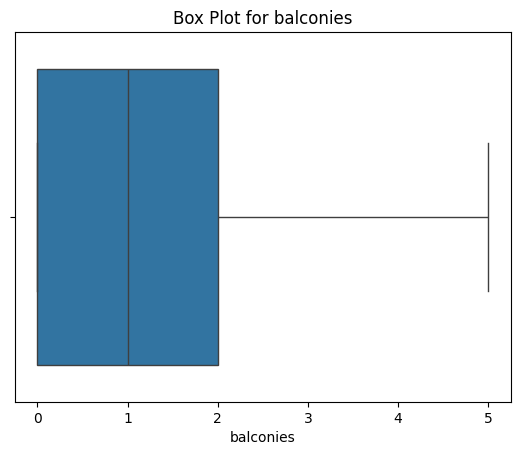

In [52]:
sns.boxplot(x=df_train1['balconies'])
plt.title('Box Plot for balconies')
plt.show()

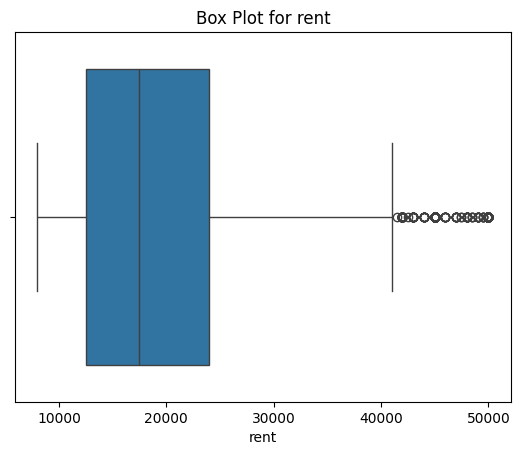

In [53]:
sns.boxplot(x=df_train1['rent'])
plt.title('Box Plot for rent')
plt.show()

In [54]:
#detecting Outlier for rent		 column
iqr = df_train1['rent'].quantile(0.75) - df_train1['rent'].quantile(0.25)
upper_threshold = df_train1['rent'].quantile(0.75) + (1.5 * iqr)
lower_threshold = df_train1['rent'].quantile(0.25) - (1.5 * iqr)
upper_threshold, lower_threshold

(41250.0, -4750.0)

In [108]:
#removing outlier for rent column
# Clip/ Strip is used to detuct value to lower & upper threshold.
df_train1.rent		 = df_train1.rent	.clip(lower_threshold, upper_threshold)

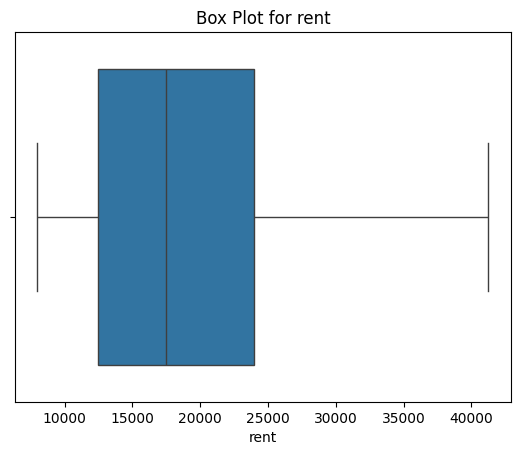

In [56]:
sns.boxplot(x=df_train1['rent'])
plt.title('Box Plot for rent')
plt.show()

In [57]:
df_train1.describe()

,latitude,longitude,gym,lift,swimming_pool,negotiable,property_size,property_age,bathroom,cup_board,floor,total_floor,balconies,rent,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,activation_day,activation_month,activation_year,no_of_amenities
count,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000,20377.000000
mean,12.945750,77.637238,0.226235,0.361142,0.174461,0.711488,1047.630809,5.657629,1.846911,2.161309,1.534843,3.302498,1.146538,18951.302694,0.661825,0.042548,0.185601,0.192865,0.291701,0.234676,0.037150,0.472984,0.471512,0.099917,0.506012,0.246503,0.170535,0.198557,0.364921,0.238553,15.344555,6.325072,2017.637336,5.177700
std,0.029587,0.110758,0.418404,0.480344,0.379515,0.453081,428.775999,5.230976,0.667887,1.325336,1.202713,1.699405,0.984580,8133.445869,0.473100,0.201841,0.388794,0.394557,0.454557,0.423807,0.189133,0.499282,0.499200,0.299896,0.499976,0.430986,0.376112,0.398924,0.481420,0.426209,8.864386,3.251640,0.480781,4.570412
min,12.900004,77.500072,0.000000,0.000000,0.000000,0.000000,1.000000,-1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,8000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,2017.000000,0.000000
25%,12.918232,77.571912,0.000000,0.000000,0.000000,0.000000,700.000000,1.000000,1.000000,1.000000,1.000000,2.000000,0.000000,12500.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,4.000000,2017.000000,2.000000
50%,12.943792,77.633367,0.000000,0.000000,0.000000,1.000000,1044.000000,5.000000,2.000000,2.000000,1.000000,3.000000,1.000000,17500.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15.000000,6.000000,2018.000000,3.000000
75%,12.970922,77.695692,0.000000,1.000000,0.000000,1.000000,1280.000000,10.000000,2.000000,3.000000,2.000000,4.000000,2.000000,24000.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,23.000000,9.000000,2018.000000,8.000000
max,12.999999,80.266346,1.000000,1.000000,1.000000,1.000000,2150.000000,23.500000,3.500000,6.000000,3.500000,7.000000,5.000000,41250.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,31.000000,12.000000,2018.000000,19.000000


In [58]:
# rearrange the columns order

df_train1= df_train1[['activation_day', 'activation_month', 'activation_year', 'locality', 'latitude', 'longitude', 'type', 'lease_type',
           'property_size', 'property_age', 'furnishing', 'facing', 'floor', 'total_floor', 'building_type', 'water_supply',
           'negotiable', 'cup_board', 'balconies', 'parking', 'bathroom', 'gym', 'lift', 'swimming_pool', 'internet', 'ac',
           'club', 'intercom', 'cpa', 'fs', 'servant', 'security', 'sc', 'gp', 'park', 'rwh', 'stp', 'hk', 'pb', 'vp', 'no_of_amenities', 'rent']]

df_train1.head()


,activation_day,activation_month,activation_year,locality,latitude,longitude,type,lease_type,property_size,property_age,furnishing,facing,floor,total_floor,building_type,water_supply,negotiable,cup_board,balconies,parking,bathroom,gym,lift,swimming_pool,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,no_of_amenities,rent
0,10,9,2017,Bellandur,12.929557,77.672280,BHK2,ANYONE,1400,4.0,SEMI_FURNISHED,NE,3.0,4.0,AP,CORPORATION,1,2.0,2.0,BOTH,2.0,0,1,0,0,0,0.0,0,0.0,0,0.0,1,1,0.0,1,1.0,1.0,0,1,1.0,8.0,22000.0
1,6,12,2018,Thiruvanmiyur,12.982870,80.262012,BHK3,FAMILY,1350,6.0,SEMI_FURNISHED,E,1.0,5.0,AP,CORP_BORE,0,3.0,3.0,BOTH,3.0,0,1,0,0,0,0.0,0,1.0,0,0.0,0,1,0.0,1,0.0,0.0,0,1,1.0,6.0,28000.0
2,20,7,2018,Attiguppe,12.955991,77.531634,BHK1,FAMILY,600,3.0,SEMI_FURNISHED,E,1.0,2.0,IH,CORPORATION,1,1.0,0.0,TWO_WHEELER,1.0,0,0,0,0,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0,0.0,8000.0
3,31,5,2018,Kodihalli,12.963903,77.649446,BHK3,FAMILY,1500,15.0,SEMI_FURNISHED,E,0.0,0.0,IH,CORPORATION,1,4.0,1.0,BOTH,3.0,0,0,0,0,0,0.0,0,1.0,0,0.0,0,0,0.0,1,0.0,0.0,0,0,1.0,3.0,41250.0
4,24,10,2017,"Seetharampalya,Hoodi",12.986196,77.718314,BHK1,FAMILY,1080,0.0,SEMI_FURNISHED,E,3.0,5.0,AP,CORP_BORE,1,1.0,2.0,BOTH,2.0,1,1,1,0,0,1.0,0,1.0,1,0.0,1,0,0.0,0,0.0,0.0,0,1,0.0,8.0,18000.0


**Unique Values of Categorical Column**

In [59]:
df_train1.nunique()

activation_day         31
activation_month       12
activation_year         2
locality             1917
latitude            17625
longitude           17617
type                    9
lease_type              4
property_size        1033
property_age           26
furnishing              3
facing                  8
floor                   5
total_floor             8
building_type           4
water_supply            3
negotiable              2
cup_board               7
balconies               6
parking                 4
bathroom                4
gym                     2
lift                    2
swimming_pool           2
internet                2
ac                      2
club                    2
intercom                2
cpa                     2
fs                      2
servant                 2
security                2
sc                      2
gp                      2
park                    2
rwh                     2
stp                     2
hk                      2
pb          

In [60]:
print("Unique values of type \n")
print(df_train1['type'].unique())

Unique values of type 

['BHK2' 'BHK3' 'BHK1' 'RK1' 'BHK4' 'BHK4PLUS' '1BHK1' 'bhk2' 'bhk3']


In [61]:
# Assuming df is your DataFrame and 'type' is the column to be corrected
df_train1['type'] = df_train1['type'].str.upper()  # Convert all values to uppercase for consistency
df_train1['type'] = df_train1['type'].str.replace('1BHK1', 'BHK1')  # Correct '1BHK1' to 'BHK1'
df_train1['type'] = df_train1['type'].str.replace('BHK', 'BHK')  # Correct variations of 'bhk' to 'BHK'

# Display unique values after correction
print(df_train1['type'].unique())

['BHK2' 'BHK3' 'BHK1' 'RK1' 'BHK4' 'BHK4PLUS']


In [62]:
print("Unique values of lease_type \n")
print(df_train1['lease_type'].unique())

Unique values of lease_type 

['ANYONE' 'FAMILY' 'BACHELOR' 'COMPANY']


In [63]:
print("Unique values of furnishing \n")
print(df_train1['furnishing'].unique())

Unique values of furnishing 

['SEMI_FURNISHED' 'FULLY_FURNISHED' 'NOT_FURNISHED']


In [64]:
print("Unique values of parking \n")
print(df_train1['parking'].unique())

Unique values of parking 

['BOTH' 'TWO_WHEELER' 'NONE' 'FOUR_WHEELER']


In [65]:
print("Unique values of facing \n")
print(df_train1['facing'].unique())

Unique values of facing 

['NE' 'E' 'S' 'N' 'SE' 'W' 'NW' 'SW']


In [66]:
print("Unique values of water_supply \n")
print(df_train1['water_supply'].unique())

Unique values of water_supply 

['CORPORATION' 'CORP_BORE' 'BOREWELL']


In [67]:
print("Unique values of building_type  \n")
print(df_train1['building_type'].unique())

Unique values of building_type  

['AP' 'IH' 'IF' 'GC']


**ENCODING**

In [68]:
# encoding the categorical features into numerical features

df_train1['type'] = df_train1['type'].map({'RK1':0, 'BHK1':1, 'BHK2':2, 'BHK3':3, 'BHK4':4, 'BHK4PLUS':5})
df_train1['facing'] = df_train1['facing'].map({'N':1, 'E':2, 'W':3, 'S':4, 'NE':5, 'NW':6, 'SE':7, 'SW':8})
df_train1['lease_type'] = df_train1['lease_type'].map({'BACHELOR':1, 'FAMILY':2, 'COMPANY':3, 'ANYONE':4})
df_train1['furnishing'] = df_train1['furnishing'].map({'NOT_FURNISHED':0, 'SEMI_FURNISHED':1, 'FULLY_FURNISHED':2})
df_train1['parking'] = df_train1['parking'].map({'NONE':0, 'TWO_WHEELER':1, 'FOUR_WHEELER':2, 'BOTH':3})
df_train1['water_supply'] = df_train1['water_supply'].map({'CORPORATION':1, 'CORP_BORE':2, 'BOREWELL':3,})
df_train1['building_type'] = df_train1['building_type'].map({'AP':1, 'IH':2, 'IF':3, 'GC':4})

In [69]:
df_train1.head()


,activation_day,activation_month,activation_year,locality,latitude,longitude,type,lease_type,property_size,property_age,furnishing,facing,floor,total_floor,building_type,water_supply,negotiable,cup_board,balconies,parking,bathroom,gym,lift,swimming_pool,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,no_of_amenities,rent
0,10,9,2017,Bellandur,12.929557,77.672280,2,4,1400,4.0,1,5,3.0,4.0,1,1,1,2.0,2.0,3,2.0,0,1,0,0,0,0.0,0,0.0,0,0.0,1,1,0.0,1,1.0,1.0,0,1,1.0,8.0,22000.0
1,6,12,2018,Thiruvanmiyur,12.982870,80.262012,3,2,1350,6.0,1,2,1.0,5.0,1,2,0,3.0,3.0,3,3.0,0,1,0,0,0,0.0,0,1.0,0,0.0,0,1,0.0,1,0.0,0.0,0,1,1.0,6.0,28000.0
2,20,7,2018,Attiguppe,12.955991,77.531634,1,2,600,3.0,1,2,1.0,2.0,2,1,1,1.0,0.0,1,1.0,0,0,0,0,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0,0.0,8000.0
3,31,5,2018,Kodihalli,12.963903,77.649446,3,2,1500,15.0,1,2,0.0,0.0,2,1,1,4.0,1.0,3,3.0,0,0,0,0,0,0.0,0,1.0,0,0.0,0,0,0.0,1,0.0,0.0,0,0,1.0,3.0,41250.0
4,24,10,2017,"Seetharampalya,Hoodi",12.986196,77.718314,1,2,1080,0.0,1,2,3.0,5.0,1,2,1,1.0,2.0,3,2.0,1,1,1,0,0,1.0,0,1.0,1,0.0,1,0,0.0,0,0.0,0.0,0,1,0.0,8.0,18000.0


# **EDA**

**1. Correlation Analysis**

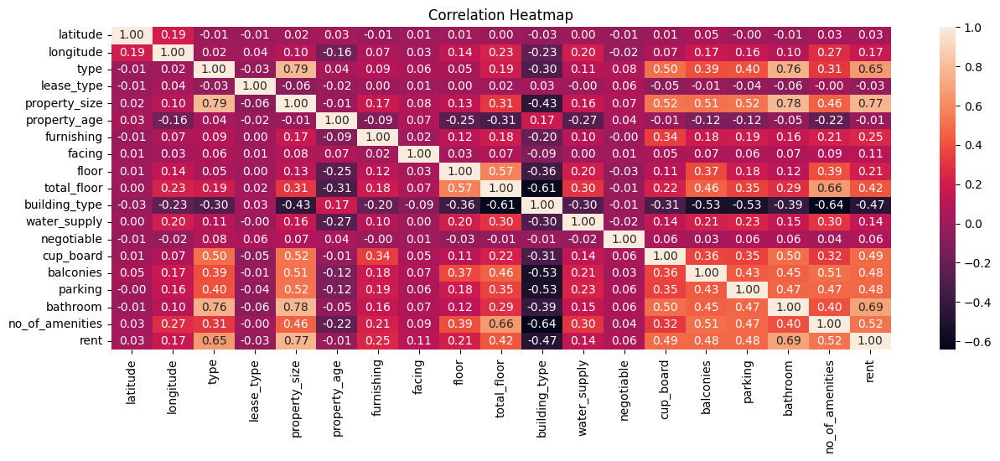

In [ ]:
# Calculate the correlation matrix
df1_corr = df_train1[['latitude', 'longitude', 'type', 'lease_type', 'property_size', 'property_age', 'furnishing', 'facing', 'floor', 'total_floor',
                'building_type', 'water_supply', 'negotiable', 'cup_board', 'balconies', 'parking', 'bathroom', 'no_of_amenities', 'rent']].corr()

# Create a heatmap
plt.figure(figsize=(15, 5))  # Adjust the figure size if needed
sns.heatmap(df1_corr, annot=True, fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

**2.Geospatial Analysis**

In [ ]:
import folium
from folium.plugins import HeatMap


# Create a folium map centered at the mean of the coordinates
mean_lat = df_train['latitude'].mean()
mean_lon = df_train['longitude'].mean()
map_heatmap = folium.Map(location=[mean_lat, mean_lon], zoom_start=10)

# Extract the latitude and longitude pairs from the DataFrame and convert to a list of lists
locations = df_train[['latitude', 'longitude']].values.tolist()

# Plot the heatmap based on the locations
HeatMap(locations).add_to(map_heatmap)

map_heatmap

In [ ]:
import folium
from folium.plugins import MarkerCluster

# Create a base map centered at a specific location
m_rent = folium.Map(location=[mean_lat, mean_lon], zoom_start=10)

# Create a MarkerCluster to add markers efficiently
marker_cluster_rent = MarkerCluster().add_to(m_rent)

# Iterate through your dataset and add markers to the map
for index, row in df_train.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"Rent: {row['rent']}",
        icon=None,
    ).add_to(marker_cluster_rent)

In [ ]:
m_rent

**3.Temporal Analysis**

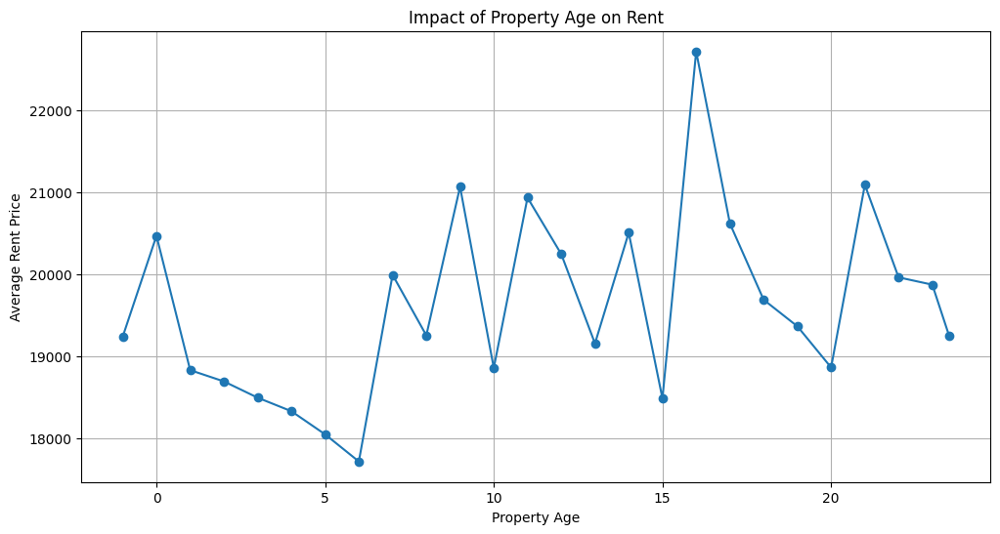

In [ ]:
# Impact of property age on rent over time
property_age_rent_trend = df_train1.groupby('property_age')['rent'].mean()

# Plotting property age vs. average rent
plt.figure(figsize=(12, 6))
property_age_rent_trend.plot(marker='o')
plt.title('Impact of Property Age on Rent')
plt.xlabel('Property Age')
plt.ylabel('Average Rent Price')
plt.grid(True)
plt.show()

**4.Property Features and Rent**

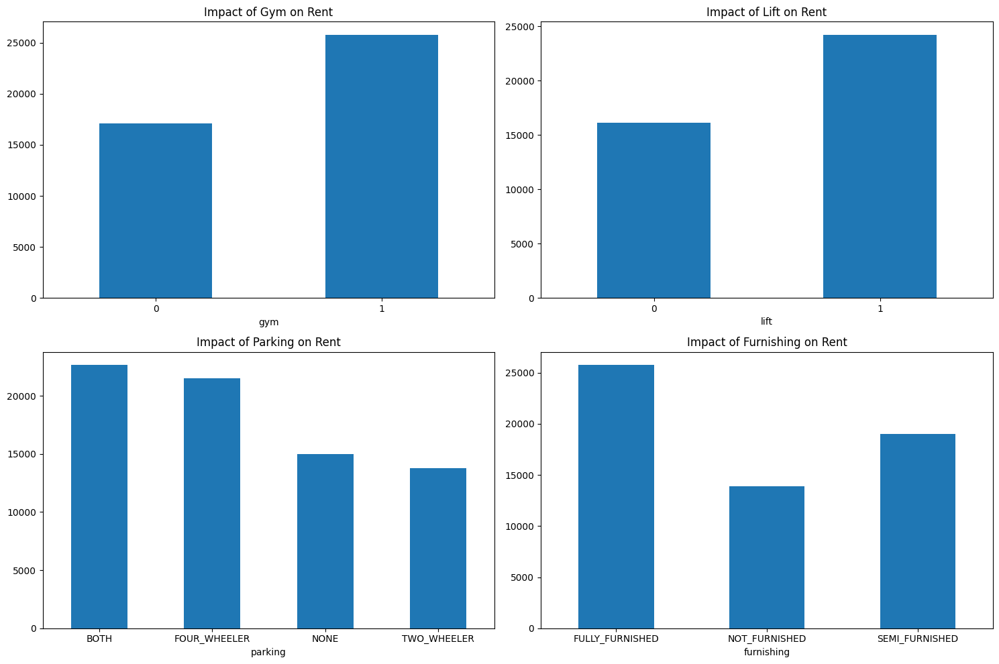

In [ ]:
# Impact of gym on rent
gym_rent_trend = df_train1.groupby('gym')['rent'].mean()

# Impact of lift on rent
lift_rent_trend = df_train1.groupby('lift')['rent'].mean()

# Impact of parking on rent
parking_rent_trend = df_train1.groupby('parking')['rent'].mean()

# Impact of furnishing on rent
furnishing_rent_trend = df_train1.groupby('furnishing')['rent'].mean()

# Plotting the trends
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

gym_rent_trend.plot(kind='bar', ax=axes[0, 0], rot=0)
axes[0, 0].set_title('Impact of Gym on Rent')

lift_rent_trend.plot(kind='bar', ax=axes[0, 1], rot=0)
axes[0, 1].set_title('Impact of Lift on Rent')

parking_rent_trend.plot(kind='bar', ax=axes[1, 0], rot=0)
axes[1, 0].set_title('Impact of Parking on Rent')

furnishing_rent_trend.plot(kind='bar', ax=axes[1, 1], rot=0)
axes[1, 1].set_title('Impact of Furnishing on Rent')

plt.tight_layout()
plt.show()

**5. Building Characteristics**

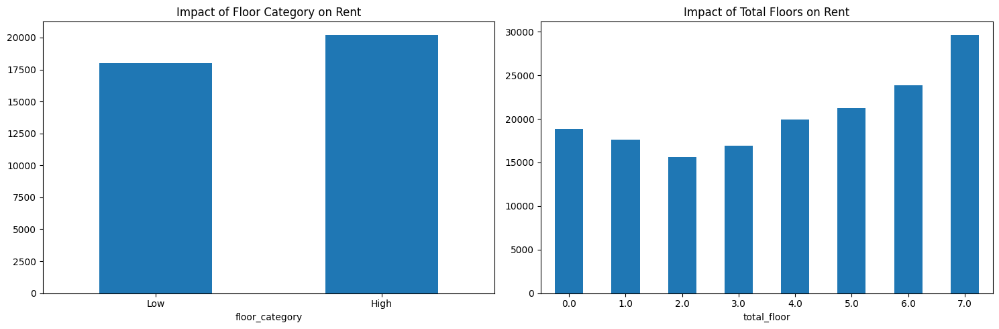

In [ ]:
# Create a new column 'floor_category' to categorize buildings as 'High' or 'Low'
df_train1['floor_category'] = pd.cut(df_train1['floor'], bins=[-float('inf'), df_train1['floor'].median(), float('inf')], labels=['Low', 'High'])

# Impact of floor category on rent
floor_category_rent_trend = df_train1.groupby('floor_category')['rent'].mean()

# Impact of total floors on rent
total_floor_rent_trend = df_train1.groupby('total_floor')['rent'].mean()

# Plotting the trends
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

floor_category_rent_trend.plot(kind='bar', ax=axes[0], rot=0)
axes[0].set_title('Impact of Floor Category on Rent')

total_floor_rent_trend.plot(kind='bar', ax=axes[1], rot=0)
axes[1].set_title('Impact of Total Floors on Rent')

plt.tight_layout()
plt.show()

**6. Negotiability and Rent**

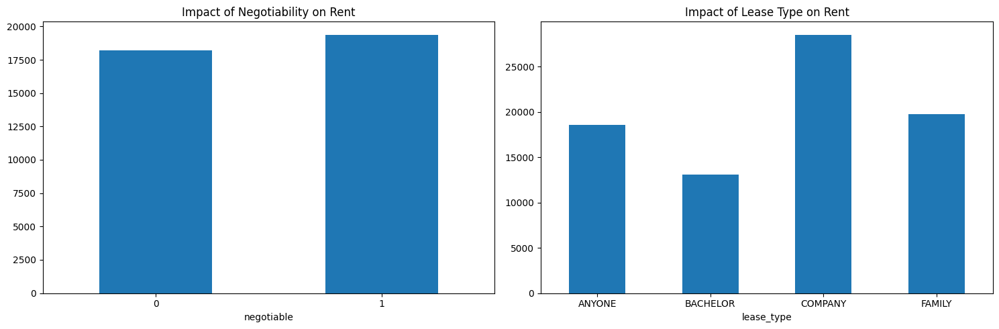

In [ ]:
# Impact of negotiability on rent
negotiability_rent_trend = df_train1.groupby('negotiable')['rent'].mean()

# Impact of lease type on rent
lease_type_rent_trend = df_train1.groupby('lease_type')['rent'].mean()

# Plotting the trends
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

negotiability_rent_trend.plot(kind='bar', ax=axes[0], rot=0)
axes[0].set_title('Impact of Negotiability on Rent')

lease_type_rent_trend.plot(kind='bar', ax=axes[1], rot=0)
axes[1].set_title('Impact of Lease Type on Rent')

plt.tight_layout()
plt.show()

**7. Balconies and Rent**

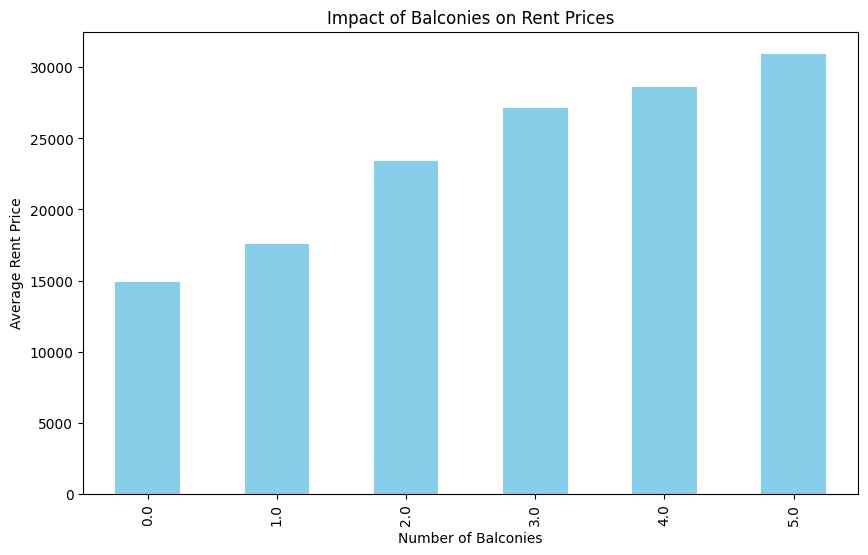

In [ ]:
# Impact of balconies on rent
balconies_rent_relation = df_train1.groupby('balconies')['rent'].mean()
# Plotting bar plot
plt.figure(figsize=(10, 6))
balconies_rent_relation.plot(kind='bar', color='skyblue')
plt.xlabel('Number of Balconies')
plt.ylabel('Average Rent Price')
plt.title('Impact of Balconies on Rent Prices')
plt.show()

**8. Amenities and Rent**

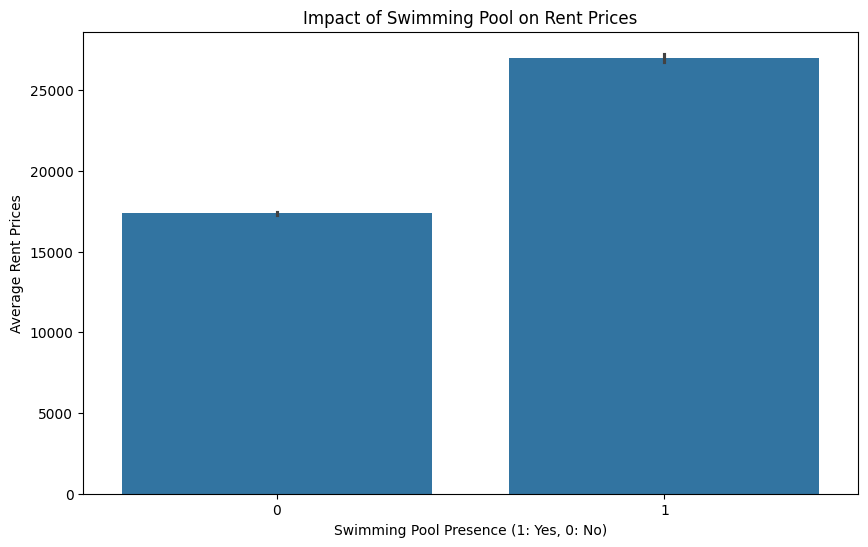

In [ ]:
# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x='swimming_pool', y='rent', data=df_train1)
plt.title("Impact of Swimming Pool on Rent Prices")
plt.xlabel("Swimming Pool Presence (1: Yes, 0: No)")
plt.ylabel("Average Rent Prices")
plt.show()

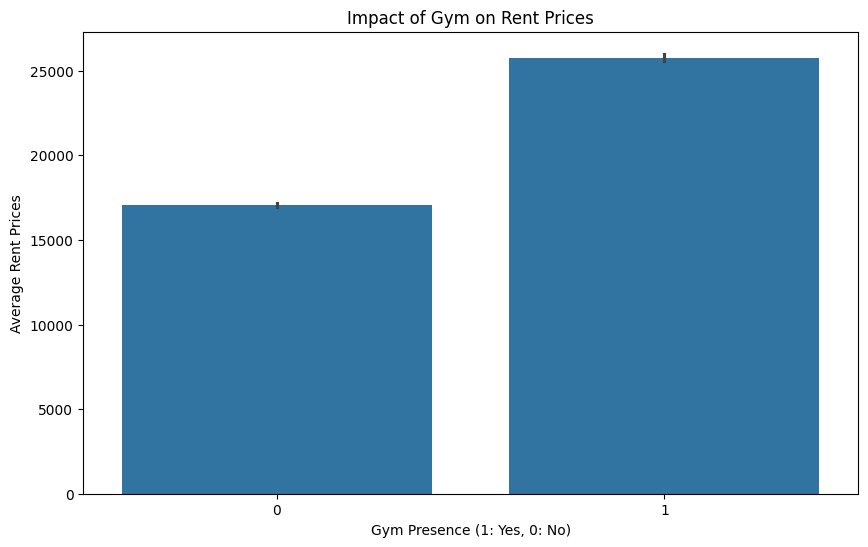

In [ ]:
# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x='gym', y='rent', data=df_train1)
plt.title("Impact of Gym on Rent Prices")
plt.xlabel("Gym Presence (1: Yes, 0: No)")
plt.ylabel("Average Rent Prices")
plt.show()

**9. Water Supply and Building Type**

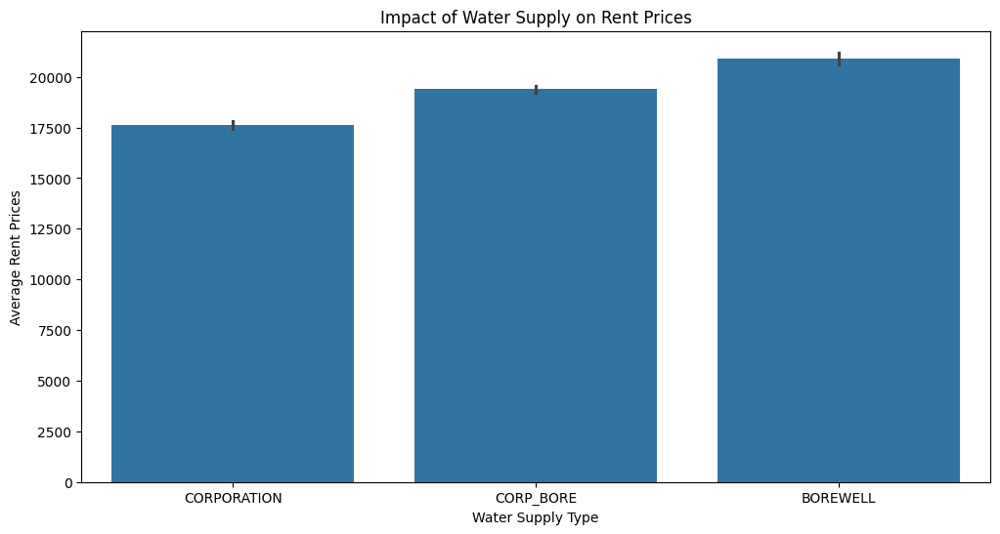

In [ ]:
# Create a bar plot for Water Supply
plt.figure(figsize=(12, 6))
sns.barplot(x='water_supply', y='rent', data=df_train1)
plt.title("Impact of Water Supply on Rent Prices")
plt.xlabel("Water Supply Type")
plt.ylabel("Average Rent Prices")
plt.show()

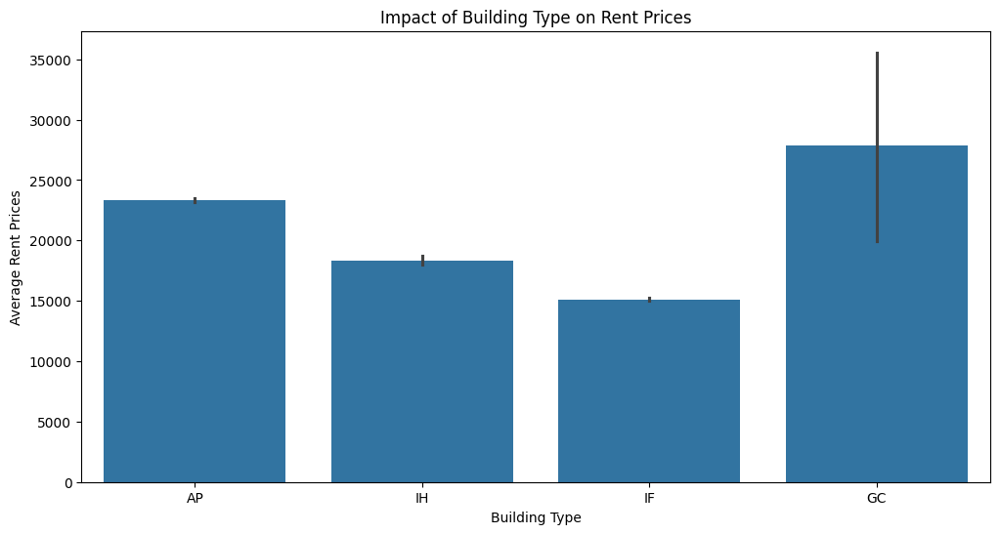

In [ ]:
# Create a bar plot for Building Type
plt.figure(figsize=(12, 6))
sns.barplot(x='building_type', y='rent', data=df_train1)
plt.title("Impact of Building Type on Rent Prices")
plt.xlabel("Building Type")
plt.ylabel("Average Rent Prices")
plt.show()

In [79]:
df_train1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20377 entries, 0 to 20376
Data columns (total 42 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   activation_day    20377 non-null  int64  
 1   activation_month  20377 non-null  int64  
 2   activation_year   20377 non-null  int64  
 3   locality          20377 non-null  object 
 4   latitude          20377 non-null  float64
 5   longitude         20377 non-null  float64
 6   type              20377 non-null  int64  
 7   lease_type        20377 non-null  int64  
 8   property_size     20377 non-null  int64  
 9   property_age      20377 non-null  float64
 10  furnishing        20377 non-null  int64  
 11  facing            20377 non-null  int64  
 12  floor             20377 non-null  float64
 13  total_floor       20377 non-null  float64
 14  building_type     20377 non-null  int64  
 15  water_supply      20377 non-null  int64  
 16  negotiable        20377 non-null  int64 

**Feature and Target Selection**

In [70]:
# X --> Feature y-- >target
x = df_train1.drop(columns=['locality', 'rent'], axis=1)
y = df_train1['rent']


**split**

In [71]:
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.2,random_state=42)

**Model**

LINEAR REGRESSION

In [72]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Assuming X_train, y_train, X_test, y_test are already defined

reg = LinearRegression().fit(x_train, y_train)

y_pred_train = reg.predict(x_train)
y_pred_test = reg.predict(x_test)

mse_train = mean_squared_error(y_train, y_pred_train)
r2_train = r2_score(y_train, y_pred_train)
mae_train = mean_absolute_error(y_train, y_pred_train)

mse_test = mean_squared_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)
mae_test = mean_absolute_error(y_test, y_pred_test)

print("MSE - Train: {:.4f} Test: {:.4f}".format(mse_train, mse_test))
print("R2 - Train: {:.4f} Test: {:.4f}".format(r2_train, r2_test))
print("MAE - Train: {:.4f} Test: {:.4f}".format(mae_train, mae_test))

MSE - Train: 20849486.5530 Test: 21933647.6508
R2 - Train: 0.6858 Test: 0.6640
MAE - Train: 3462.0066 Test: 3516.6253


DECISION TREE

In [73]:
from sklearn.tree import DecisionTreeRegressor


# Create a Decision Tree Regressor
dt = DecisionTreeRegressor(random_state=42)

# Fit the model to the training data
dt.fit(x_train, y_train)

# Predict the values for the training and testing sets
y_pred_train = dt.predict(x_train)
y_pred_test = dt.predict(x_test)

# Compute the MSE, MAE, and R2 for the training set
mse_train = mean_squared_error(y_train, y_pred_train)
r2_train = r2_score(y_train, y_pred_train)
mae_train = mean_absolute_error(y_train, y_pred_train)

# Compute the MSE, MAE, and R2 for the testing set
mse_test = mean_squared_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)
mae_test = mean_absolute_error(y_test, y_pred_test)

# Print the results
print("MSE - Train: {:.4f} Test: {:.4f}".format(mse_train, mse_test))
print("R2 - Train: {:.4f} Test: {:.4f}".format(r2_train, r2_test))
print("MAE - Train: {:.4f} Test: {:.4f}".format(mae_train, mae_test))

MSE - Train: 0.0000 Test: 25363078.5221
R2 - Train: 1.0000 Test: 0.6115
MAE - Train: 0.0000 Test: 3581.4073


RANDOM FOREST

In [74]:
from sklearn.ensemble import RandomForestRegressor


# Create a Random Forest Regressor
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
rf.fit(x_train, y_train)

# Predict the values for the training and testing sets
y_pred_train = rf.predict(x_train)
y_pred_test = rf.predict(x_test)

# Compute the MSE, MAE, and R2 for the training set
mse_train = mean_squared_error(y_train, y_pred_train)
r2_train = r2_score(y_train, y_pred_train)
mae_train = mean_absolute_error(y_train, y_pred_train)

# Compute the MSE, MAE, and R2 for the testing set
mse_test = mean_squared_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)
mae_test = mean_absolute_error(y_test, y_pred_test)

# Print the results
print("MSE - Train: {:.4f} Test: {:.4f}".format(mse_train, mse_test))
print("MAE - Train: {:.4f} Test: {:.4f}".format(mae_train, mae_test))
print("R2 - Train: {:.4f} Test: {:.4f}".format(r2_train, r2_test))

MSE - Train: 1754617.3584 Test: 12630481.3137
MAE - Train: 950.0067 Test: 2572.9071
R2 - Train: 0.9736 Test: 0.8065


XGBOOST

In [ ]:
import xgboost as xgb
# Create an XGBoost Regressor with 'reg:linear' objective
XGB = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=500, seed=42)

# Fit the model to the training data
XGB.fit(x_train, y_train)

# Predict the values for the training and testing sets
y_pred_train = XGB.predict(x_train)
y_pred_test = XGB.predict(x_test)

# Compute the MSE, MAE, and R2 for the training set
mse_train = mean_squared_error(y_train, y_pred_train)
r2_train = r2_score(y_train, y_pred_train)
mae_train = mean_absolute_error(y_train, y_pred_train)

# Compute the MSE, MAE, and R2 for the testing set
mse_test = mean_squared_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)
mae_test = mean_absolute_error(y_test, y_pred_test)

# Print the results
print("MSE - Train: {:.4f} Test: {:.4f}".format(mse_train, mse_test))
print("MAE - Train: {:.4f} Test: {:.4f}".format(mae_train, mae_test))
print("R2 - Train: {:.4f} Test: {:.4f}".format(r2_train, r2_test))

MSE - Train: 490277.6162 Test: 12575957.0234
MAE - Train: 491.9133 Test: 2565.3215
R2 - Train: 0.9926 Test: 0.8074


**LOAD TEST DATA**

In [80]:
df_test = pd.read_excel("/content/House_Rent_Test.xlsx")

In [81]:
df_test.head()

,id,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,amenities,water_supply,building_type,balconies
0,ff8081815df539bc015df947ce976cca,BHK2,Basavanagudi,22-08-2017 09:00,12.941603,77.568156,FAMILY,0,1,0,0,SEMI_FURNISHED,BOTH,1300,1,2,N,2,3,3,"{""LIFT"":true,""GYM"":false,""INTERNET"":false,""AC""...",CORP_BORE,AP,1
1,ff80818157288e9301572c05651853a6,BHK2,Rajaji Nagar,17-09-2017 16:33,12.998803,77.561887,ANYONE,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,600,7,1,S,2,0,3,"{""LIFT"":false,""GYM"":false,""INTERNET"":true,""AC""...",CORPORATION,IF,0
2,ff8081815f1afc58015f1b831fde166e,BHK1,Jeevan Bima Nagar,14-04-2018 17:27,12.966467,77.661063,ANYONE,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,600,10,1,S,1,0,1,"{""LIFT"":false,""GYM"":false,""INTERNET"":true,""AC""...",CORPORATION,IF,0
3,ff8081816035b31901603f7922c046e0,BHK1,Jayanagar 1st Block,2017-11-12 13:15:00,12.941533,77.592606,ANYONE,0,0,0,0,NOT_FURNISHED,TWO_WHEELER,500,8,1,E,0,2,2,"{""LIFT"":false,""GYM"":false,""INTERNET"":true,""AC""...",CORP_BORE,IF,0
4,ff8081815c3582f5015c38fc31aa73a4,BHK3,Whitefield Hope Farm Junction,2017-11-07 16:44:00,12.971083,77.751625,ANYONE,1,1,1,1,SEMI_FURNISHED,BOTH,1400,0,3,E,3,3,4,"{""LIFT"":true,""GYM"":true,""INTERNET"":true,""AC"":f...",BOREWELL,AP,1


In [82]:
# Checking size(rows,columns) of dataset
df_test.shape

(4500, 24)

In [83]:
#checking for null values
df_test.isnull().sum()

id                 0
type               0
locality           0
activation_date    0
latitude           0
longitude          0
lease_type         0
gym                0
lift               0
swimming_pool      0
negotiable         0
furnishing         0
parking            0
property_size      0
property_age       0
bathroom           0
facing             0
cup_board          0
floor              0
total_floor        0
amenities          0
water_supply       0
building_type      0
balconies          0
dtype: int64

In [84]:
df_test.loc[0,'amenities']

'{"LIFT":true,"GYM":false,"INTERNET":false,"AC":false,"CLUB":false,"INTERCOM":false,"POOL":false,"CPA":false,"FS":true,"SERVANT":false,"SECURITY":true,"SC":false,"GP":false,"PARK":false,"RWH":false,"STP":false,"HK":false,"PB":true,"VP":false}'

In [85]:
df_test.loc[5,'amenities']

'{"LIFT":false,"GYM":false,"INTERNET":true,"AC":false,"CLUB":false,"INTERCOM":false,"POOL":false,"CPA":false,"FS":false,"SERVANT":false,"SECURITY":false,"SC":false,"GP":false,"PARK":false,"RWH":false,"STP":false,"HK":false,"PB":false,"VP":false}'

In [86]:

# convert string dictionary into dictionary

def amenities_encoding(amenities):

    # load the string dictionary to json [convert true=True and false=False - boolean format]
    a = json.loads(amenities)

    # value = True means convert to 1, else convert to 0 ----> [so True convert to 1 and False convert to 0]
    b = {key:1 if value else 0 for key,value in a.items()}

    # remove the existing column in df
    for i in ['LIFT','GYM','POOL']:
        b.pop(i, None)

    return b

In [87]:
# string dictionary convert to dictionary

df_test['amenities'] = df_test['amenities'].apply(lambda x: amenities_encoding(x))
df_test.tail(3)

,id,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,amenities,water_supply,building_type,balconies
4497,ff808181629ac9860162a7ac1a4253bb,BHK1,"Jeevan Samskruthi Apartment, Shiridi Sai Templ...",30-05-2018 16:10,12.949315,77.713807,ANYONE,0,0,0,1,SEMI_FURNISHED,NONE,500,10,1,W,1,2,3,"{'SC': 0, 'INTERCOM': 0, 'AC': 0, 'PB': 0, 'HK...",CORP_BORE,IH,0
4498,ff8081815b57c717015b580af22f1bbd,BHK3,Mullur,2018-11-07 16:17:00,12.914104,77.716428,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1450,1,3,N,4,10,10,"{'SC': 0, 'INTERCOM': 1, 'AC': 0, 'PB': 1, 'HK...",BOREWELL,AP,3
4499,ff808181615af5c101616150bd28356e,BHK3,Kaikondrahalli,27-03-2018 16:25,12.915296,77.676694,FAMILY,1,1,1,0,SEMI_FURNISHED,FOUR_WHEELER,1500,10,3,E,7,5,8,"{'INTERNET': 0, 'AC': 0, 'CLUB': 0, 'INTERCOM'...",BOREWELL,AP,3


In [88]:
# make new dataframe for amenities dictionary
amenities_df = pd.DataFrame(df_test['amenities'].tolist(), index=df_test.index)

# column names convert to lower case
amenities_df.columns = amenities_df.columns.str.lower()
amenities_df.tail()

,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp
4495,1,0,0.0,0,0.0,0,0.0,1,1,0.0,0,0.0,0.0,0,0,0.0
4496,1,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0
4497,0,0,NaN,0,NaN,0,NaN,1,0,NaN,0,NaN,NaN,0,0,NaN
4498,1,0,NaN,1,NaN,1,NaN,1,0,NaN,1,NaN,NaN,0,1,NaN
4499,0,0,0.0,1,0.0,1,0.0,0,1,0.0,1,0.0,0.0,1,1,0.0


In [89]:

# concatinate amenities dataframe with df

df_test = pd.concat([df_test, amenities_df], axis=1)
df_test.drop(columns='amenities', inplace=True)
df_test.tail()

,id,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp
4495,ff8081815216f51101521aa9d46c191f,BHK2,Hanumanthnagar,2018-10-06 18:22:00,12.941654,77.559999,FAMILY,0,0,0,1,SEMI_FURNISHED,BOTH,950,2,2,N,2,3,3,CORP_BORE,IF,2,1,0,0.0,0,0.0,0,0.0,1,1,0.0,0,0.0,0.0,0,0,0.0
4496,ff8081816098166901609bf52bb702a8,BHK2,Lakkasandra,21-01-2018 14:36,12.942973,77.597738,ANYONE,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,750,10,1,N,2,2,3,CORPORATION,IF,1,1,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0
4497,ff808181629ac9860162a7ac1a4253bb,BHK1,"Jeevan Samskruthi Apartment, Shiridi Sai Templ...",30-05-2018 16:10,12.949315,77.713807,ANYONE,0,0,0,1,SEMI_FURNISHED,NONE,500,10,1,W,1,2,3,CORP_BORE,IH,0,0,0,NaN,0,NaN,0,NaN,1,0,NaN,0,NaN,NaN,0,0,NaN
4498,ff8081815b57c717015b580af22f1bbd,BHK3,Mullur,2018-11-07 16:17:00,12.914104,77.716428,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1450,1,3,N,4,10,10,BOREWELL,AP,3,1,0,NaN,1,NaN,1,NaN,1,0,NaN,1,NaN,NaN,0,1,NaN
4499,ff808181615af5c101616150bd28356e,BHK3,Kaikondrahalli,27-03-2018 16:25,12.915296,77.676694,FAMILY,1,1,1,0,SEMI_FURNISHED,FOUR_WHEELER,1500,10,3,E,7,5,8,BOREWELL,AP,3,0,0,0.0,1,0.0,1,0.0,0,1,0.0,1,0.0,0.0,1,1,0.0


In [90]:
df_test.isnull().sum()

id                   0
type                 0
locality             0
activation_date      0
latitude             0
longitude            0
lease_type           0
gym                  0
lift                 0
swimming_pool        0
negotiable           0
furnishing           0
parking              0
property_size        0
property_age         0
bathroom             0
facing               0
cup_board            0
floor                0
total_floor          0
water_supply         0
building_type        0
balconies            0
internet             0
ac                   0
club               216
intercom             0
cpa                216
fs                   0
servant            216
security             0
sc                   0
gp                 216
park                 0
rwh                216
stp                216
hk                   0
pb                   0
vp                 216
dtype: int64

In [91]:
# Handling null values ---> replace with 0

df_test.fillna(0, inplace=True)
df_test.tail()

,id,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp
4495,ff8081815216f51101521aa9d46c191f,BHK2,Hanumanthnagar,2018-10-06 18:22:00,12.941654,77.559999,FAMILY,0,0,0,1,SEMI_FURNISHED,BOTH,950,2,2,N,2,3,3,CORP_BORE,IF,2,1,0,0.0,0,0.0,0,0.0,1,1,0.0,0,0.0,0.0,0,0,0.0
4496,ff8081816098166901609bf52bb702a8,BHK2,Lakkasandra,21-01-2018 14:36,12.942973,77.597738,ANYONE,0,0,0,1,SEMI_FURNISHED,TWO_WHEELER,750,10,1,N,2,2,3,CORPORATION,IF,1,1,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0
4497,ff808181629ac9860162a7ac1a4253bb,BHK1,"Jeevan Samskruthi Apartment, Shiridi Sai Templ...",30-05-2018 16:10,12.949315,77.713807,ANYONE,0,0,0,1,SEMI_FURNISHED,NONE,500,10,1,W,1,2,3,CORP_BORE,IH,0,0,0,0.0,0,0.0,0,0.0,1,0,0.0,0,0.0,0.0,0,0,0.0
4498,ff8081815b57c717015b580af22f1bbd,BHK3,Mullur,2018-11-07 16:17:00,12.914104,77.716428,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1450,1,3,N,4,10,10,BOREWELL,AP,3,1,0,0.0,1,0.0,1,0.0,1,0,0.0,1,0.0,0.0,0,1,0.0
4499,ff808181615af5c101616150bd28356e,BHK3,Kaikondrahalli,27-03-2018 16:25,12.915296,77.676694,FAMILY,1,1,1,0,SEMI_FURNISHED,FOUR_WHEELER,1500,10,3,E,7,5,8,BOREWELL,AP,3,0,0,0.0,1,0.0,1,0.0,0,1,0.0,1,0.0,0.0,1,1,0.0


In [92]:
df_test.isnull().sum()

id                 0
type               0
locality           0
activation_date    0
latitude           0
longitude          0
lease_type         0
gym                0
lift               0
swimming_pool      0
negotiable         0
furnishing         0
parking            0
property_size      0
property_age       0
bathroom           0
facing             0
cup_board          0
floor              0
total_floor        0
water_supply       0
building_type      0
balconies          0
internet           0
ac                 0
club               0
intercom           0
cpa                0
fs                 0
servant            0
security           0
sc                 0
gp                 0
park               0
rwh                0
stp                0
hk                 0
pb                 0
vp                 0
dtype: int64

In [93]:
# data type convertion
df_test['activation_date'] = pd.to_datetime(df_test['activation_date'])
df_test.tail(2)

,id,type,locality,activation_date,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp
4498,ff8081815b57c717015b580af22f1bbd,BHK3,Mullur,2018-11-07 16:17:00,12.914104,77.716428,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1450,1,3,N,4,10,10,BOREWELL,AP,3,1,0,0.0,1,0.0,1,0.0,1,0,0.0,1,0.0,0.0,0,1,0.0
4499,ff808181615af5c101616150bd28356e,BHK3,Kaikondrahalli,2018-03-27 16:25:00,12.915296,77.676694,FAMILY,1,1,1,0,SEMI_FURNISHED,FOUR_WHEELER,1500,10,3,E,7,5,8,BOREWELL,AP,3,0,0,0.0,1,0.0,1,0.0,0,1,0.0,1,0.0,0.0,1,1,0.0


In [94]:
# date column split into day, month, year columns

df_test['activation_day'] = df_test['activation_date'].dt.day
df_test['activation_month'] = df_test['activation_date'].dt.month
df_test['activation_year'] = df_test['activation_date'].dt.year
df_test.drop(columns='activation_date', inplace=True)
df_test.tail(3)

,id,type,locality,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,activation_day,activation_month,activation_year
4497,ff808181629ac9860162a7ac1a4253bb,BHK1,"Jeevan Samskruthi Apartment, Shiridi Sai Templ...",12.949315,77.713807,ANYONE,0,0,0,1,SEMI_FURNISHED,NONE,500,10,1,W,1,2,3,CORP_BORE,IH,0,0,0,0.0,0,0.0,0,0.0,1,0,0.0,0,0.0,0.0,0,0,0.0,30,5,2018
4498,ff8081815b57c717015b580af22f1bbd,BHK3,Mullur,12.914104,77.716428,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1450,1,3,N,4,10,10,BOREWELL,AP,3,1,0,0.0,1,0.0,1,0.0,1,0,0.0,1,0.0,0.0,0,1,0.0,7,11,2018
4499,ff808181615af5c101616150bd28356e,BHK3,Kaikondrahalli,12.915296,77.676694,FAMILY,1,1,1,0,SEMI_FURNISHED,FOUR_WHEELER,1500,10,3,E,7,5,8,BOREWELL,AP,3,0,0,0.0,1,0.0,1,0.0,0,1,0.0,1,0.0,0.0,1,1,0.0,27,3,2018


In [95]:
# calculate the count of amenities

df_test['no_of_amenities'] = df_test['gym'] + df_test['lift'] + df_test['swimming_pool'] + df_test['internet'] + df_test['ac'] + df_test['club'] + df_test['intercom'] + df_test['cpa'] + df_test['fs'] + df_test['servant'] + df_test['security'] + df_test['sc'] + df_test['gp'] + df_test['park'] + df_test['rwh'] + df_test['stp'] + df_test['hk'] + df_test['pb'] + df_test['vp']
df_test.tail(3)

,id,type,locality,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,activation_day,activation_month,activation_year,no_of_amenities
4497,ff808181629ac9860162a7ac1a4253bb,BHK1,"Jeevan Samskruthi Apartment, Shiridi Sai Templ...",12.949315,77.713807,ANYONE,0,0,0,1,SEMI_FURNISHED,NONE,500,10,1,W,1,2,3,CORP_BORE,IH,0,0,0,0.0,0,0.0,0,0.0,1,0,0.0,0,0.0,0.0,0,0,0.0,30,5,2018,1.0
4498,ff8081815b57c717015b580af22f1bbd,BHK3,Mullur,12.914104,77.716428,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1450,1,3,N,4,10,10,BOREWELL,AP,3,1,0,0.0,1,0.0,1,0.0,1,0,0.0,1,0.0,0.0,0,1,0.0,7,11,2018,9.0
4499,ff808181615af5c101616150bd28356e,BHK3,Kaikondrahalli,12.915296,77.676694,FAMILY,1,1,1,0,SEMI_FURNISHED,FOUR_WHEELER,1500,10,3,E,7,5,8,BOREWELL,AP,3,0,0,0.0,1,0.0,1,0.0,0,1,0.0,1,0.0,0.0,1,1,0.0,27,3,2018,9.0


In [96]:
df_test.describe()

,latitude,longitude,gym,lift,swimming_pool,negotiable,property_size,property_age,bathroom,cup_board,floor,total_floor,balconies,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,activation_day,activation_month,activation_year,no_of_amenities
count,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000,4500.000000
mean,12.946577,77.638205,0.223111,0.366889,0.173111,0.719333,1072.577778,5.827111,1.874667,2.244222,1.918222,3.850889,1.166444,0.670667,0.045111,0.192667,0.203556,0.313111,0.239333,0.046889,0.468667,0.470667,0.106444,0.516889,0.255556,0.176889,0.201111,0.375556,0.237778,15.578444,6.429111,2017.620667,5.284000
std,0.029694,0.116819,0.416379,0.482009,0.378385,0.449375,590.043133,15.800894,0.950581,1.610327,2.201149,3.273722,1.074915,0.470023,0.207571,0.394437,0.402687,0.463811,0.426724,0.211424,0.499073,0.499194,0.308440,0.499770,0.436222,0.381617,0.400875,0.484320,0.425770,8.958963,3.229820,0.485275,4.657055
min,12.900007,77.500096,0.000000,0.000000,0.000000,0.000000,1.000000,-1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,2017.000000,0.000000
25%,12.919406,77.572006,0.000000,0.000000,0.000000,0.000000,700.000000,1.000000,1.000000,1.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,4.000000,2017.000000,2.000000
50%,12.944424,77.632945,0.000000,0.000000,0.000000,1.000000,1064.000000,5.000000,2.000000,2.000000,1.000000,3.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15.000000,7.000000,2018.000000,3.000000
75%,12.971717,77.697231,0.000000,1.000000,0.000000,1.000000,1300.000000,9.000000,2.000000,3.000000,3.000000,4.000000,2.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,24.000000,9.000000,2018.000000,8.000000
max,12.999929,80.257515,1.000000,1.000000,1.000000,1.000000,20000.000000,999.000000,34.000000,30.000000,21.000000,50.000000,22.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,31.000000,12.000000,2018.000000,19.000000


In [97]:
# remove the negative value in property_age column

df_test = df_test[df_test['property_age']>=0].reset_index(drop=True)
df_test.tail(3)

,id,type,locality,latitude,longitude,lease_type,gym,lift,swimming_pool,negotiable,furnishing,parking,property_size,property_age,bathroom,facing,cup_board,floor,total_floor,water_supply,building_type,balconies,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,activation_day,activation_month,activation_year,no_of_amenities
4487,ff808181629ac9860162a7ac1a4253bb,BHK1,"Jeevan Samskruthi Apartment, Shiridi Sai Templ...",12.949315,77.713807,ANYONE,0,0,0,1,SEMI_FURNISHED,NONE,500,10,1,W,1,2,3,CORP_BORE,IH,0,0,0,0.0,0,0.0,0,0.0,1,0,0.0,0,0.0,0.0,0,0,0.0,30,5,2018,1.0
4488,ff8081815b57c717015b580af22f1bbd,BHK3,Mullur,12.914104,77.716428,FAMILY,1,1,1,1,SEMI_FURNISHED,BOTH,1450,1,3,N,4,10,10,BOREWELL,AP,3,1,0,0.0,1,0.0,1,0.0,1,0,0.0,1,0.0,0.0,0,1,0.0,7,11,2018,9.0
4489,ff808181615af5c101616150bd28356e,BHK3,Kaikondrahalli,12.915296,77.676694,FAMILY,1,1,1,0,SEMI_FURNISHED,FOUR_WHEELER,1500,10,3,E,7,5,8,BOREWELL,AP,3,0,0,0.0,1,0.0,1,0.0,0,1,0.0,1,0.0,0.0,1,1,0.0,27,3,2018,9.0


In [98]:
df_test.describe()

,latitude,longitude,gym,lift,swimming_pool,negotiable,property_size,property_age,bathroom,cup_board,floor,total_floor,balconies,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,activation_day,activation_month,activation_year,no_of_amenities
count,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000,4490.000000
mean,12.946577,77.638161,0.223385,0.366815,0.173274,0.719599,1073.064143,5.842316,1.875278,2.245434,1.916258,3.849666,1.166592,0.671269,0.045212,0.192650,0.203786,0.313140,0.239198,0.046993,0.468820,0.470824,0.106682,0.516927,0.255902,0.176615,0.201336,0.375724,0.237639,15.577506,6.431849,2017.619822,5.286192
std,0.029683,0.116899,0.416561,0.481989,0.378526,0.449245,590.480996,15.815194,0.951269,1.611217,2.194107,3.271127,1.075600,0.469804,0.207791,0.394425,0.402857,0.463823,0.426642,0.211648,0.499082,0.499204,0.308742,0.499769,0.436416,0.381385,0.401043,0.484363,0.425684,8.964666,3.232219,0.485485,4.658468
min,12.900007,77.500096,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,2017.000000,0.000000
25%,12.919414,77.571857,0.000000,0.000000,0.000000,0.000000,700.000000,1.000000,1.000000,1.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,4.000000,2017.000000,2.000000
50%,12.944406,77.632929,0.000000,0.000000,0.000000,1.000000,1065.000000,5.000000,2.000000,2.000000,1.000000,3.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15.000000,7.000000,2018.000000,3.000000
75%,12.971724,77.697042,0.000000,1.000000,0.000000,1.000000,1300.000000,9.000000,2.000000,3.000000,3.000000,4.000000,2.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,24.000000,9.000000,2018.000000,8.000000
max,12.999929,80.257515,1.000000,1.000000,1.000000,1.000000,20000.000000,999.000000,34.000000,30.000000,21.000000,50.000000,22.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,31.000000,12.000000,2018.000000,19.000000


In [99]:
# rearrange the columns order

df_test = df_test[['activation_day', 'activation_month', 'activation_year', 'locality', 'latitude', 'longitude', 'type', 'lease_type',
           'property_size', 'property_age', 'furnishing', 'facing', 'floor', 'total_floor', 'building_type', 'water_supply',
           'negotiable', 'cup_board', 'balconies', 'parking', 'bathroom', 'gym', 'lift', 'swimming_pool', 'internet', 'ac',
           'club', 'intercom', 'cpa', 'fs', 'servant', 'security', 'sc', 'gp', 'park', 'rwh', 'stp', 'hk', 'pb', 'vp', 'no_of_amenities',]]

df_test.tail()

,activation_day,activation_month,activation_year,locality,latitude,longitude,type,lease_type,property_size,property_age,furnishing,facing,floor,total_floor,building_type,water_supply,negotiable,cup_board,balconies,parking,bathroom,gym,lift,swimming_pool,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,no_of_amenities
4485,6,10,2018,Hanumanthnagar,12.941654,77.559999,BHK2,FAMILY,950,2,SEMI_FURNISHED,N,3,3,IF,CORP_BORE,1,2,2,BOTH,2,0,0,0,1,0,0.0,0,0.0,0,0.0,1,1,0.0,0,0.0,0.0,0,0,0.0,3.0
4486,21,1,2018,Lakkasandra,12.942973,77.597738,BHK2,ANYONE,750,10,SEMI_FURNISHED,N,2,3,IF,CORPORATION,1,2,1,TWO_WHEELER,1,0,0,0,1,0,0.0,0,0.0,0,0.0,0,0,0.0,0,0.0,0.0,0,0,0.0,1.0
4487,30,5,2018,"Jeevan Samskruthi Apartment, Shiridi Sai Templ...",12.949315,77.713807,BHK1,ANYONE,500,10,SEMI_FURNISHED,W,2,3,IH,CORP_BORE,1,1,0,NONE,1,0,0,0,0,0,0.0,0,0.0,0,0.0,1,0,0.0,0,0.0,0.0,0,0,0.0,1.0
4488,7,11,2018,Mullur,12.914104,77.716428,BHK3,FAMILY,1450,1,SEMI_FURNISHED,N,10,10,AP,BOREWELL,1,4,3,BOTH,3,1,1,1,1,0,0.0,1,0.0,1,0.0,1,0,0.0,1,0.0,0.0,0,1,0.0,9.0
4489,27,3,2018,Kaikondrahalli,12.915296,77.676694,BHK3,FAMILY,1500,10,SEMI_FURNISHED,E,5,8,AP,BOREWELL,0,7,3,FOUR_WHEELER,3,1,1,1,0,0,0.0,1,0.0,1,0.0,0,1,0.0,1,0.0,0.0,1,1,0.0,9.0


In [100]:
# encoding the categorical features into numerical features

df_test['type'] = df_test['type'].map({'RK1':0, 'BHK1':1, 'BHK2':2, 'BHK3':3, 'BHK4':4, 'BHK4PLUS':5})
df_test['facing'] = df_test['facing'].map({'N':1, 'E':2, 'W':3, 'S':4, 'NE':5, 'NW':6, 'SE':7, 'SW':8})
df_test['lease_type'] = df_test['lease_type'].map({'BACHELOR':1, 'FAMILY':2, 'COMPANY':3, 'ANYONE':4})
df_test['furnishing'] = df_test['furnishing'].map({'NOT_FURNISHED':0, 'SEMI_FURNISHED':1, 'FULLY_FURNISHED':2})
df_test['parking'] = df_test['parking'].map({'NONE':0, 'TWO_WHEELER':1, 'FOUR_WHEELER':2, 'BOTH':3})
df_test['water_supply'] = df_test['water_supply'].map({'CORPORATION':1, 'CORP_BORE':2, 'BOREWELL':3,})
df_test['building_type'] = df_test['building_type'].map({'AP':1, 'IH':2, 'IF':3, 'GC':4})

In [101]:
df_test.head(3)

,activation_day,activation_month,activation_year,locality,latitude,longitude,type,lease_type,property_size,property_age,furnishing,facing,floor,total_floor,building_type,water_supply,negotiable,cup_board,balconies,parking,bathroom,gym,lift,swimming_pool,internet,ac,club,intercom,cpa,fs,servant,security,sc,gp,park,rwh,stp,hk,pb,vp,no_of_amenities
0,22,8,2017,Basavanagudi,12.941603,77.568156,2,2,1300,1,1,1,3,3,1,2,0,2,1,3,2,0,1,0,0,0,0.0,0,0.0,1,0.0,1,0,0.0,0,0.0,0.0,0,1,0.0,4.0
1,17,9,2017,Rajaji Nagar,12.998803,77.561887,2,4,600,7,1,4,0,3,3,1,1,2,0,1,1,0,0,0,1,0,0.0,0,0.0,0,0.0,0,1,0.0,1,1.0,0.0,0,0,0.0,4.0
2,14,4,2018,Jeevan Bima Nagar,12.966467,77.661063,1,4,600,10,1,4,0,1,3,1,1,1,0,1,1,0,0,0,1,0,0.0,0,0.0,0,0.0,0,1,0.0,1,1.0,0.0,0,1,0.0,5.0


In [102]:
df_test.drop([ 'locality'], axis=1, inplace=True)

In [103]:
test_predictions = rf.predict(df_test)

In [104]:
# Save predictions to a sample submission file without the 'id' column
sample_submission = pd.DataFrame({'rent': test_predictions})
sample_submission.to_csv('sample_submission.csv', index=False)

In [105]:
# Round the predicted rent values to the nearest integer
rounded_predictions = test_predictions.round()

# Create a DataFrame for the sample submission without the 'id' column
sample_submission = pd.DataFrame({'rent': rounded_predictions})

# Save the rounded predictions to a CSV file
sample_submission.to_csv('sample_submission.csv', index=False)

**PREDICTED RENT**

In [75]:
# Example X_new for a single data point
X_new = pd.DataFrame({
    'activation_day': [10],
    'activation_month': [9],
    'activation_year': [2017],
    'latitude': [12.929557],
    'longitude': [77.672280	],
    'type': [2],
    'lease_type': [4],
    'property_size': ['1400'],
    'property_age': [4],
    'furnishing': [1],
    'facing': ['5'],
    'floor': [3],
    'total_floor': [4],
    'building_type': ['1'],
    'water_supply': [1],
    'negotiable': [1],
    'cup_board': [2],
    'balconies': ['2'],
    'parking': ['3'],
    'bathroom': ['2'],
    'gym': ['0'],
    'lift': ['1'],
    'swimming_pool': ['0'],
    'internet': ['0'],
    'ac': ['0'],
    'club': ['0'],
    'intercom':['0'],
    'cpa': ['0'],
    'fs': ['0'],
    'servant':['0'],
    'security': ['1'],
    'sc': ['1'],
    'gp': ['0'],
    'park': ['1'],
    'rwh': ['1'],
    'stp': ['1'],
    'hk': ['0'],
    'pb': ['1'],
    'vp': ['1'],
    'no_of_amenities': ['8']


})


# Predict the rent for the new values
predicted_rent =rf.predict(X_new)

# Round the predicted rent to the nearest integer using numpy.round
rent = np.round(predicted_rent)

# Display the rounded predicted rent
print("rent:", rent)

rent: [24455.]


**SAVE THE MODEL**

In [78]:
import pickle
pickle.dump(rf, open('houserent.pkl', 'wb'))